# Fault Detection & Diagnosis Pipeline Woodland Way
### _FYP: Continuous Condition Assessment of Automatic Control Valves_
#### _Imperial College London_
#### _Department of Civil & Environmental Engineering_
#### _Megat Riza Makhzan_

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from datetime import datetime, timedelta
import time
import glob
import os
import csv 
from numpy import cumsum
import matplotlib.dates as mdates
from collections import Counter
from matplotlib.patches import Patch
from scipy.interpolate import interp1d
from dtaidistance import dtw
from scipy.signal import find_peaks
from matplotlib.lines import Line2D
from scipy import stats
from joblib import Parallel, delayed
from sklearn.metrics import ( mean_squared_error, mean_absolute_error, classification_report, confusion_matrix, average_precision_score)
import matplotlib.dates as mdates
from scipy.stats import t as student_t
from sklearn.pipeline         import Pipeline
from sklearn.preprocessing    import StandardScaler, PolynomialFeatures
from sklearn.linear_model     import LinearRegression
from dtaidistance import dtw
from scipy.signal import find_peaks
import time
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import ( precision_score, recall_score, f1_score, accuracy_score, balanced_accuracy_score)



# suppress unnecessary warnings
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

C:\Users\megat\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.4SP5SUA7CBGXUEOC35YP2ASOICYYEQZZ.gfortran-win_amd64.dll
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
print(pd. __version__)           # 1.4.0
print(matplotlib. __version__)   # 3.5.0
print(np. __version__)           # 1.22.4
print(sns. __version__)          # 0.11.2

1.4.0
3.5.0
1.22.4
0.11.2


In [3]:
%matplotlib inline

# plt settings
plot_size   = 30
plot_width  = 60
plot_height = 30

params = {'legend.fontsize': plot_width,
          'figure.figsize': (plot_width,plot_height),
          'axes.labelsize': plot_width,
          'axes.titlesize': plot_width*1.5,
          'xtick.labelsize': plot_width,
          'ytick.labelsize': plot_width,
          'axes.titlepad': plot_width,
          'font.size': plot_width,
          'font.family': 'sans-serif',  
          'font.sans-serif': 'Arial',
          'axes.linewidth':    2,
          'grid.linewidth': 1}
plt.rcParams.update(params)

## 1. Load data

1. Initialise strings 
2. Load data (uncomment as required)
    - Native 1 minute / sample
    - Fixed 5-min windows
    - 10-minute windows with 50% overlap
3. Compute rate of change
4. Compute coefficient of variation (CV)
5. Define periods of fixed outlet pressure
6. Define control profiles


In [4]:
Pout_str = 'pressure_out'
Pin_str = 'pressure_in'
Pres_str = 'residual_pressure'
Flow_str = 'flow'
Pc_str = 'pressure_chamber'
Stem_str = 'valve_position'
Normalised_str = 'normalised_residual_pressure'
Ptarget_str = 'pressure_target'
Flow_roc_str = 'Flow_rate_of_change'
Pout_roc_str = 'Pout_rate_of_change'
Pin_roc_str = 'Pin_rate_of_change'

In [5]:
Window = 1
Step = 1
T1_str = '1-min'

Flow_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Flow_Final.csv", parse_dates=[0], index_col=0)
Pin_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Pin_Final.csv", parse_dates=[0], index_col=0)
Pout_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Pout_Final.csv", parse_dates=[0], index_col=0)
Ptarget_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Ptarget_final.csv", parse_dates=[0], index_col=0)
Pres_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Pres_Final.csv", parse_dates=[0], index_col=0)
Normalised_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Normalised_Final.csv", parse_dates=[0], index_col=0)
Stem_1T = pd.read_csv("../../Data/StokeLane/ProcessedData/Stem_final.csv", parse_dates=[0], index_col=0)

In [6]:
Window = 5
Step = 5
T_str = '5-min Windowed'

Flow = pd.read_csv("../../Data/StokeLane/ProcessedData/Flow5T_Final.csv", parse_dates=[0], index_col=0)
Pin = pd.read_csv("../../Data/StokeLane/ProcessedData/Pin5T_Final.csv", parse_dates=[0], index_col=0)
Pout = pd.read_csv("../../Data/StokeLane/ProcessedData/Pout5T_Final.csv", parse_dates=[0], index_col=0)
Ptarget = pd.read_csv("../../Data/StokeLane/ProcessedData/Ptarget5T_Final.csv", parse_dates=[0], index_col=0)
Pres = pd.read_csv("../../Data/StokeLane/ProcessedData/Pres5T_Final.csv", parse_dates=[0], index_col=0)
Normalised = pd.read_csv("../../Data/StokeLane/ProcessedData/Normalised5T_Final.csv", parse_dates=[0], index_col=0)

In [7]:
Window10 = 10
Step10 = 5
T10_str = '10-min Windowed w/ 50% Overlap'

Flow10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Flow10ov_Final.csv", parse_dates=[0], index_col=0)
Pin10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Pin10ov_Final.csv", parse_dates=[0], index_col=0)
Pout10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Pout10ov_Final.csv", parse_dates=[0], index_col=0)
Ptarget10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Ptarget10ov_Final.csv", parse_dates=[0], index_col=0)
Pres10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Pres10ov_Final.csv", parse_dates=[0], index_col=0)
Normalised10 = pd.read_csv("../../Data/StokeLane/ProcessedData/Normalised10ov_Final.csv", parse_dates=[0], index_col=0)

In [8]:
Flow_roc = pd.DataFrame(Flow.diff().dropna().values / Step, index=Flow.diff().dropna().index, columns=['Flow_rate_of_change'])
Pout_roc = pd.DataFrame(Pout.diff().dropna().values / Step, index=Pout.diff().dropna().index, columns=['Pout_rate_of_change'])
Pin_roc = pd.DataFrame(Pin.diff().dropna().values / Step, index=Pin.diff().dropna().index, columns=['Pin_rate_of_change'])

In [9]:
rolling_std = Flow_1T.resample('5T').std()
rolling_mean = Flow_1T.resample('5T').mean()
Flow_cv_rolling = rolling_std / rolling_mean * 100
Flow_cv_str = 'Flow_cv'
Flow_cv_rolling = Flow_cv_rolling.rename(columns={Flow_str:Flow_cv_str})

rolling_std = Pout_1T.resample('5T').std()
rolling_mean = Pout_1T.resample('5T').mean()
Pout_cv_rolling = rolling_std / rolling_mean * 100
Pout_cv_str = 'Pout_cv'
Pout_cv_rolling = Pout_cv_rolling.rename(columns={Pout_str:'Pout_cv'})

rolling_std = Pin_1T.resample('5T').std()
rolling_mean = Pin_1T.resample('5T').mean()
Pin_cv_rolling = np.abs(rolling_std / rolling_mean) * 100
Pin_cv_str = 'Pin_cv'
Pin_cv_rolling = Pin_cv_rolling.rename(columns={Pin_str:'Pin_cv'})

In [10]:
Fixed_outlet_pressure = pd.DataFrame(index=Pout.index)
Fixed_outlet_pressure['fixed_outlet_pressure'] = 0
start = pd.Timestamp('2024-05-19 00:00:00')
end   = pd.Timestamp('2024-09-25 15:06:00')
mask  = (Fixed_outlet_pressure.index >= start) & (Fixed_outlet_pressure.index <= end)
Fixed_outlet_pressure.loc[mask, 'fixed_outlet_pressure'] = 1

The code block below establishes the control profiles for the entire dataset.

In [11]:
# 01/01/2024 00:00:00 - 14/04/2025 23:27:00
CP1 = pd.DataFrame(data = {'abb' : [   0,  0.1,  0.5,    5,   11,   14,   16,   18,   21,   22,   23,   24, 25, 26, 27,   28,   32,   50],
                      'P_target' : [32.5, 32.5, 13.3, 13.3, 14.4, 15.2, 16.2, 17.4, 19.5, 20.3, 21.3, 22.1, 23, 24, 25, 26.1, 32.5, 32.5]})

flat_start = pd.to_datetime('2024-05-17 13:03:00')
flat_end   = pd.to_datetime('2024-09-25 07:35:00')
mean_outlet = Pout['pressure_out'].loc[flat_start:flat_end].mean()
CP2 = pd.DataFrame({
    'abb': CP1['abb'].values,
    'P_target': mean_outlet
})

CP3 = CP1.copy()

# 14/04/2025 23:28:00 - 15/04/2025 09:21:00
CP4 = pd.DataFrame(data = {'abb' : [   0,  0.1,    1,    6,    8,   10,   12,   14,   16,   18,   20,   22, 24, 26, 28,   30,   32,   50],
                      'P_target' : [32.5, 32.5, 10.2, 10.7, 11.3, 11.9, 12.6, 13.4, 14.2, 15.1,   16, 17.5, 19, 20, 22,   24,   26, 32.5]})

# 15/04/2025 09:22:00 - 16/04/2025 08:13:00
CP5 = pd.DataFrame(data = {'abb' : [   0,  0.1,  0.5,    5,   11,   14,   16,   18,   21,   22,   23,   24, 25, 26, 27,   28,   32,   50],
                      'P_target' : [32.5, 32.5, 13.3, 13.3, 14.4, 15.2, 16.2, 17.4, 19.5, 20.3, 21.3, 22.1, 23, 24, 25, 26.1, 32.5, 32.5]})

# 16/04/2025 08:14:00 - 16/04/2025 12:50:00
CP6 = pd.DataFrame(data = {'abb' : [   0,  0.1,    1,    6,    8,   10,   12,   14,   16,   18,   20,   22, 24,   26, 28,   30,   32,   50],
                      'P_target' : [32.5, 32.5, 10.2, 10.7, 11.3,   12, 12.6, 13.4, 14.2, 15.1,   16,   18, 19, 20.5, 23,   25,   28, 32.5]})

# 16/04/2025 12:51:00 - 17/04/2025 15:58:00 
CP7 = pd.DataFrame(data = {'abb' : [   0,  0.5,    1,    6,    8,   10,   12,   14,   16,   18,   20,   22, 24,   26, 28,   30,   32,   50],
                      'P_target' : [32.5, 32.5,   13,   13, 13.5,   15, 15.5, 16.5, 17.2, 18.1,   19,   21, 22, 23.5, 26,   28,   29, 32.5]})

# 17/04/2025 15:59:00 - 30/04/2025 23:59:00
CP8 = pd.DataFrame(data = {'abb' : [   0,  0.5,    1,    6,    8,   10,   12,   14,   16,   18,   20,   22, 24,   26, 28,   30,   32,   50],
                      'P_target' : [32.5, 32.5,   13,   13, 13.5,   15, 15.5, 16.5, 17.2, 18.1,   19,   21, 22, 23.5, 26,   28,   29, 32.5]})

cp_periods = [
    (pd.to_datetime('2024-01-01 00:00:00'), pd.to_datetime('2024-05-17 13:02:00'), CP1),
    (pd.to_datetime('2024-05-17 13:03:00'), pd.to_datetime('2024-09-25 15:06:00'), CP2),
    (pd.to_datetime('2024-09-25 15:07:00'), pd.to_datetime('2025-04-14 23:27:00'), CP3),
    (pd.to_datetime('2025-04-14 23:28:00'), pd.to_datetime('2025-04-15 09:21:00'), CP4),
    (pd.to_datetime('2025-04-15 09:22:00'), pd.to_datetime('2025-04-16 08:13:00'), CP5),
    (pd.to_datetime('2025-04-16 08:14:00'), pd.to_datetime('2025-04-16 12:50:00'), CP6),
    (pd.to_datetime('2025-04-16 12:51:00'), pd.to_datetime('2025-04-17 15:58:00'), CP7),
    (pd.to_datetime('2025-04-17 15:59:00'), pd.to_datetime('2025-04-30 23:59:00'), CP8),
]

def get_control_curve(ts):
    """Return the correct control-curve DataFrame for a given timestamp."""
    for start, end, CPdf in cp_periods:
        if start <= ts <= end:
            return CPdf
    return CP1

## 2. Simulation of Raw Residuals w/ skewed normal thresholds

This section contains the fault detection analysis with residual pressures. The analysis is carried out using 5-minute residuals and 10-minute resiudals with a 50% overlap.

### 2.1. Fault detection model on fixed 5 min windows

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-05-01
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-08-29
    • Fitted 576 regimes at 2024-08-29
    • Fitted 0 regimes at NaT
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-04-01
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


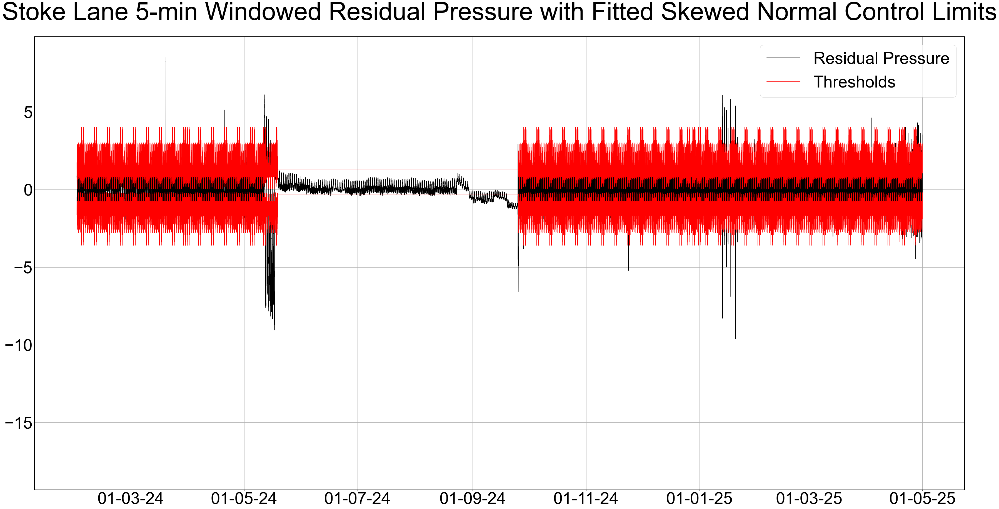

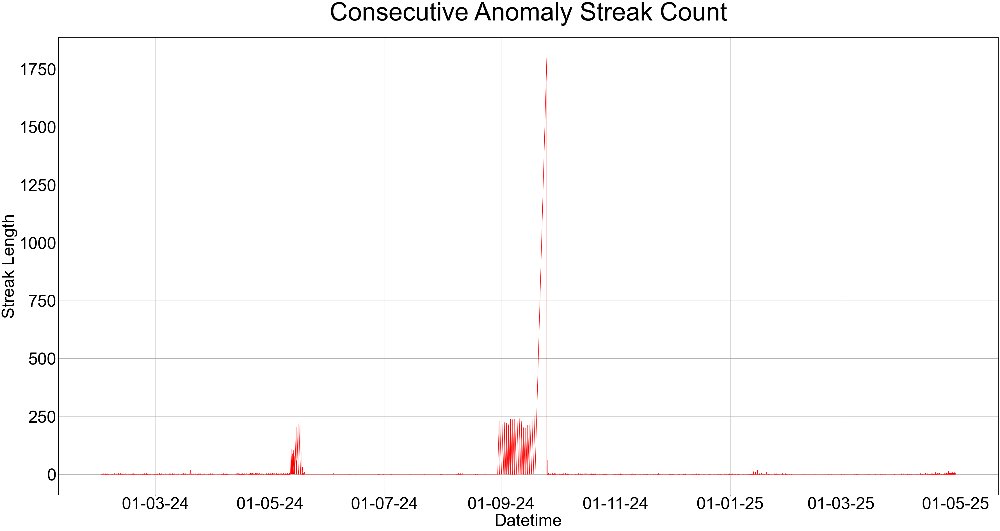

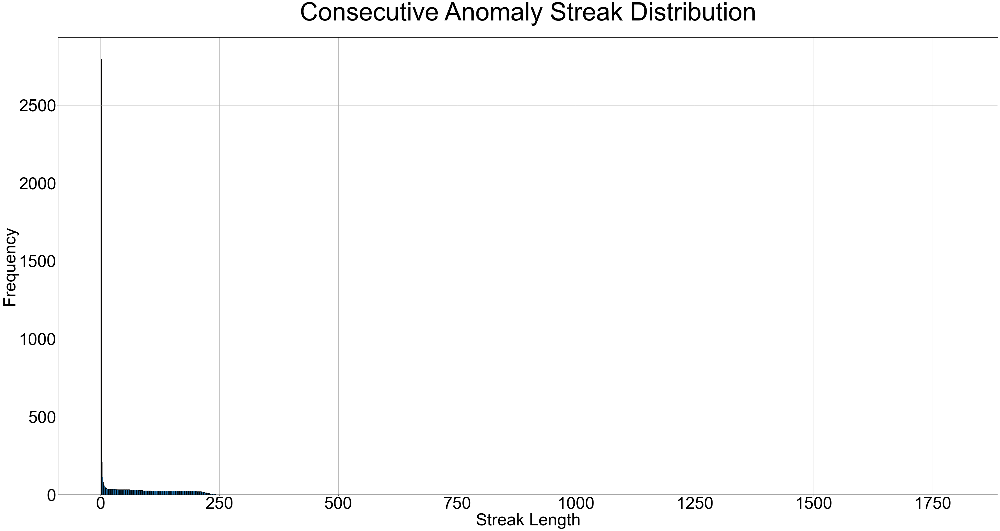

In [12]:
# ----- 0) Parameters & functions -----
value_col = Pres_str  
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}

def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Fixed outlet percentile thresholds -----
june = Pres.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -4)
static_upper = min(static_upper,  4)
print("[3/7] Static thresholds computed.")

# ----- 3) Monthly threshold function -----
def compute_pct_thresholds(df):
    
    groups = df.groupby(['time_5min','model'])[value_col]
    
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        return (t, m, max(lo, -4), min(hi, 4))
    
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- 4) Initialize window & thresholds -----
window_df = Pres.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- 5) Prepare sim_df -----
sim_df = Pres.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- 6) Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- 7) Anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- 8) Finalize & plot -----
flagged_all = merged.copy()
residual_flagged_all = flagged_all.copy()

# 1) Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Residual Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r-', label='Thresholds')
ax.plot(flagged_all.index, flagged_all['lower'], 'r-')
ax.set_title(f'Stoke Lane {T_str} Residual Pressure with Fitted Skewed Normal Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y'))
ax.legend(); ax.grid(True)
plt.show()

# 2) Anomaly streak count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y'))
ax2.grid(True)
plt.show()

# 3) Histogram of streak lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


In [13]:
flagged_all['is_anom'] = residual_flagged_all['count'] > 0

# Total anomaly‐minutes
total_anoms = flagged_all['is_anom'].sum()
print(f"Total anomaly-minutes: {total_anoms}")

# Daily anomaly counts
daily_counts = flagged_all['is_anom'].resample('D').sum()
print("\nAnomalies per day:")
print(daily_counts)


mask = flagged_all['count'] > 0
grp = (mask != mask.shift(fill_value=False)).cumsum()
event_lengths = flagged_all[mask].groupby(grp).size()

# Daily anomaly‐minutes & events
daily_minutes = mask.resample('D').sum()                     
avg_minutes   = daily_minutes.mean()                         

starts        = mask & ~mask.shift(fill_value=False)
event_dates   = pd.to_datetime(flagged_all.index[starts]).normalize()
daily_events  = event_dates.value_counts().sort_index()      
avg_events    = daily_events.mean()                          

# Count events by duration
n_single   = (event_lengths == 1).sum()
n_lt5      = (event_lengths < 5).sum()
n_lt15     = (event_lengths < 15).sum()
n_lt60     = (event_lengths < 60).sum()
n_gt1440   = (event_lengths >= 60).sum() 

print(f"Avg anomaly‐minutes per day: {avg_minutes:.1f}")
print(f"Avg anomaly‐events per day:  {avg_events:.2f}\n")

print("Event duration counts:")
print(f"  single-minute events:       {n_single}")
print(f"  events <5 min:              {n_lt5}")
print(f"  events <15 min:             {n_lt15}")
print(f"  events <1 h:                {n_lt60}")
print(f"  events >1 h:              {n_gt1440}")

# Total anomaly-minutes per month
anom_min_by_month = (flagged_all['is_anom'].resample('M').sum().loc['2024-02-01':])

month_most_min  = anom_min_by_month.idxmax().strftime('%Y-%m')
month_least_min = anom_min_by_month.idxmin().strftime('%Y-%m')

starts = (flagged_all['is_anom'] & ~flagged_all['is_anom'].shift(fill_value=False))
event_month = flagged_all.index[starts].to_period('M')
anom_evt_by_month = (event_month.value_counts().sort_index().loc[lambda s: s.index != pd.Period('2024-01')])

month_most_evt  = anom_evt_by_month.idxmax().strftime('%Y-%m')
month_least_evt = anom_evt_by_month.idxmin().strftime('%Y-%m')

print(f"Most anomaly-minutes month:  {month_most_min}")
print(f"Least anomaly-minutes month: {month_least_min}")
total_events = anom_evt_by_month.sum()
print(f"Total anomaly-events (excluding Jan 2024): {total_events}")

Total anomaly-minutes: 11525

Anomalies per day:
2024-02-01     6
2024-02-02     7
2024-02-03    12
2024-02-04    14
2024-02-05     4
              ..
2025-04-26    63
2025-04-27    79
2025-04-28    45
2025-04-29    65
2025-04-30    62
Freq: D, Name: is_anom, Length: 455, dtype: int64
Avg anomaly‐minutes per day: 25.3
Avg anomaly‐events per day:  7.87

Event duration counts:
  single-minute events:       2246
  events <5 min:              2710
  events <15 min:             2756
  events <1 h:                2762
  events >1 h:              33
Most anomaly-minutes month:  2024-09
Least anomaly-minutes month: 2024-06
Total anomaly-events (excluding Jan 2024): 2795


### 2.2. Flagged control plots

The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

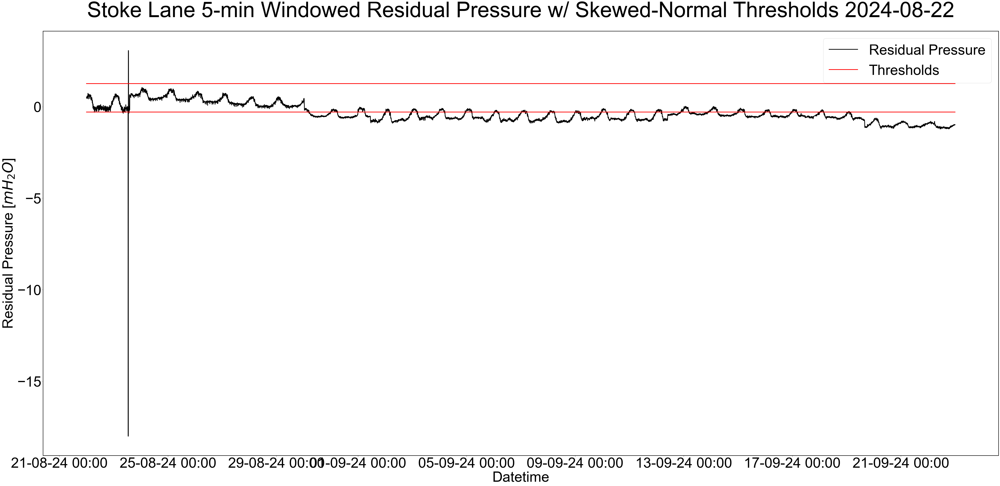

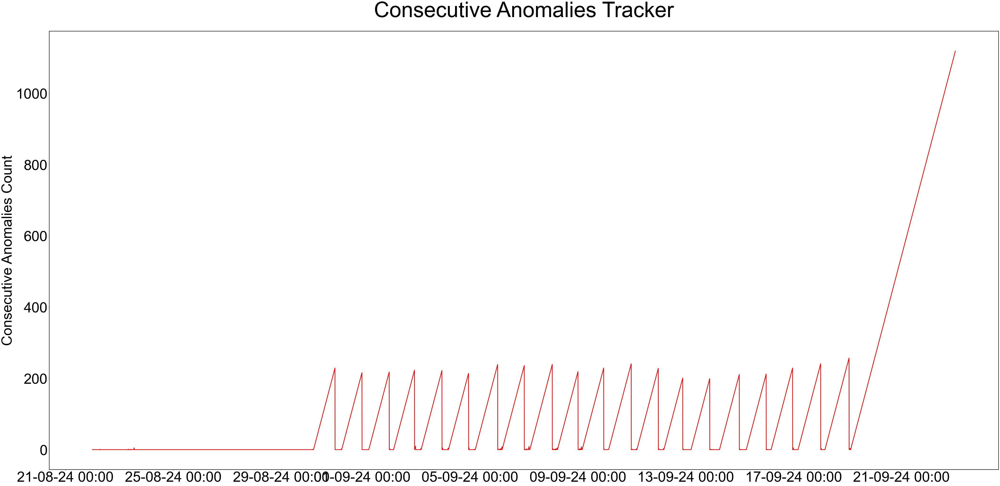

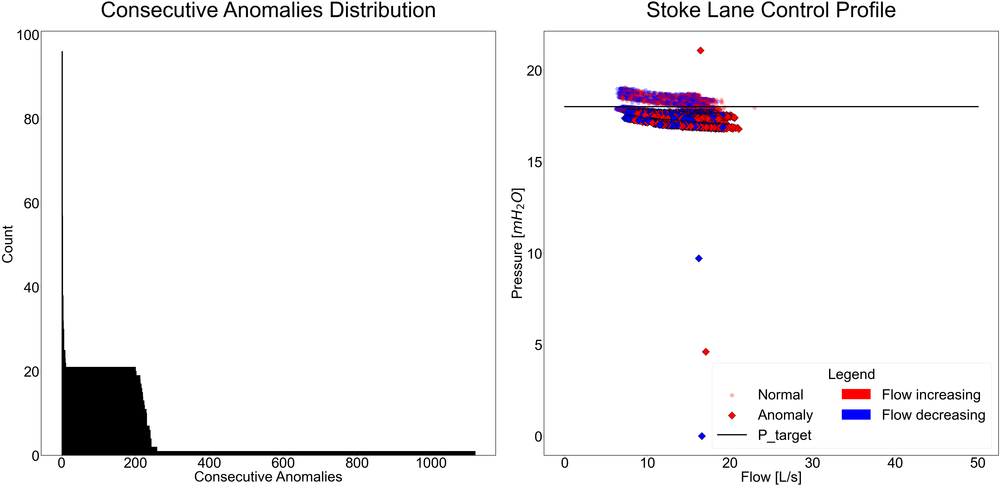

In [14]:
start, end = '2024-08-22','2024-09-22'
value_col = Pres_str

# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all[value_col].loc[start:end],
        'k-', label='Residual Pressure', linewidth = 3)
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Residual Pressure [$mH_2O$]')
ax.set_title(f'Stoke Lane {T_str} Residual Pressure w/ Skewed-Normal Thresholds {start}')
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# — Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = residual_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]

floored        = flow_plot.index.floor('5T')
counts_on_flow = residual_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0

days_with_anomalies = (
    residual_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique())

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 3
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')


sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)

sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Stoke Lane Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

In [15]:
# period_start, period_end = '2025-01-01', '2025-01-31'

# days_with_anomalies = (
#     residual_flagged_all[residual_flagged_all['count'] > 1]
#         .loc[period_start:period_end]
#         .index
#         .normalize()
#         .unique()
# )

# for day in days_with_anomalies:
#     start = pd.Timestamp(day)
#     end = start + pd.Timedelta(days=1)
#     print(f"\nPlotting for {start.date()}")

#     # Residual Pressure with thresholds
#     fig, ax = plt.subplots()
#     df_slice = residual_flagged_all.loc[start:end]
#     ax.plot(df_slice.index, df_slice[value_col], 'k-', label='Residual Pressure')
#     ax.plot(df_slice.index, df_slice['upper'], 'r--', label='Thresholds')
#     ax.plot(df_slice.index, df_slice['lower'], 'r--')
#     ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#     fig.autofmt_xdate(rotation=15)
#     ax.set_xlabel('Datetime')
#     ax.set_ylabel(r'Residual Pressure')
#     ax.set_title(f'Stoke Lane {T_str} Residual Pressure w/ Thresholds {start.date()} : {end.date()}')
#     ax.legend()
#     ax.grid(True)
#     plt.tight_layout()
#     plt.show()

#     # Consecutive Anomalies Count
#     fig, ax = plt.subplots()
#     count_slice = residual_flagged_all['count'].loc[start:end]
#     ax.plot(count_slice.index, count_slice, 'r-')
#     ax.set_ylabel('Consecutive Anomalies Count')
#     ax.set_title(f'Consecutive Anomalies Tracker {start.date()} : {end.date()}')
#     ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#     ax.grid(True)
#     plt.tight_layout()
#     plt.show()

#     # Histogram of consecutive anomalies for the day
#     hist3 = count_slice
#     fig, ax = plt.subplots()
#     sns.histplot(hist3[hist3 > 0], bins=range(1, hist3.max() + 2), ax=ax, color='pink')
#     ax.set_title(f'Consecutive Anomalies Distribution {start.date()} : {end.date()}')
#     ax.set_xlabel('Consecutive Anomalies')
#     ax.set_ylabel('Count')
#     plt.tight_layout()
#     plt.show()

#     # Cla-Val scatter with anomalies & integrated control curve plotting
#     flow_full = Flow['flow'].loc[start:end]
#     pout_full = Pout['pressure_out'].loc[start:end]
#     diff_full = flow_full.diff()
#     valid = diff_full.notna()
#     flow_plot = flow_full[valid]
#     pout_plot = pout_full[valid]
#     diff_plot = diff_full[valid]
#     colors = ['red' if d > 0 else 'blue' for d in diff_plot]

#     floored = flow_plot.index.floor('5T')
#     counts_on_flow = flagged_all['count'].reindex(floored, fill_value=0)
#     anomaly_mask = counts_on_flow.values > 0

#     fig, ax = plt.subplots()
#     sc_norm = ax.scatter(
#         flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
#         c=[c for c, m in zip(colors, anomaly_mask) if not m],
#         edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
#         s=250, alpha=0.3, label='Normal'
#     )
    
#     sc_anom = ax.scatter(
#         flow_plot[anomaly_mask], pout_plot[anomaly_mask],
#         c=[c for c, m in zip(colors, anomaly_mask) if m],
#         marker='D', edgecolor='k', s=500, label='Anomaly'
#     )

#     days_with_anomalies_curve = (
#         flagged_all[flagged_all['count'] > 1]
#             .loc[start:end]
#             .index
#             .normalize()
#             .unique()
#     )
#     for curve_day in days_with_anomalies_curve:
#         date = pd.Timestamp(curve_day)
#         CPdf = get_control_curve(date)
#         ln_curve, = ax.plot(
#             CPdf['abb'], CPdf['P_target'], linewidth=5,
#             color='black', label='P_target'
#         )

#     red_patch  = Patch(color='red',  label='Flow increasing')
#     blue_patch = Patch(color='blue', label='Flow decreasing')

#     ax.legend(
#         handles=[ln_curve, sc_norm, sc_anom, red_patch, blue_patch],
#         loc='lower right', ncol=2, title='Legend'
#     )

#     ax.set(
#         title=f"Stoke Lane Control Profile {start.date()} : {end.date()}",
#         xlabel='Flow [L/s]',
#         ylabel=r'Pressure [$mH_2O$]'
#     )
#     ax.grid(True)
#     plt.tight_layout()
#     plt.show()


### 2.3. Feature labelling

The code below collects the key features from the analysis above which will be used for fault diagnosis later on.

In [16]:
mask = residual_flagged_all['count'] >= 1
ts   = residual_flagged_all.index[mask]

flagged_features = pd.DataFrame(index=ts)
flagged_features['Flow']       = Flow         [Flow_str]       .reindex(ts)
flagged_features['Pin']        = Pin          [Pin_str]        .reindex(ts)
flagged_features['Pout']       = Pout         [Pout_str]       .reindex(ts)
flagged_features['Pres']       = Pres         [Pres_str]       .reindex(ts)
flagged_features['normalised'] = Normalised   [Normalised_str] .reindex(ts)

flagged_features['Flow_roc']   = Flow_roc     [Flow_roc_str]   .reindex(ts)
flagged_features['Pin_roc']    = Pin_roc      [Pin_roc_str]    .reindex(ts)
flagged_features['Pout_roc']   = Pout_roc     [Pout_roc_str]   .reindex(ts)

flagged_features['Flow_cv']    = Flow_cv_rolling[Flow_cv_str] .reindex(ts)
flagged_features['Pin_cv']     = Pin_cv_rolling [Pin_cv_str]   .reindex(ts)
flagged_features['Pout_cv']    = Pout_cv_rolling[Pout_cv_str].reindex(ts)

flagged_features['Fixed_outlet_pressure']   = Fixed_outlet_pressure['fixed_outlet_pressure'].reindex(ts)
flagged_features['count']   = flagged_all['count'].reindex(ts)
flagged_features['absdiff'] = flagged_all['absdiff'].reindex(ts)

,Flow,Pin,Pout,Pres,normalised,Flow_roc,Pin_roc,Pout_roc,Flow_cv,Pin_cv,Pout_cv,Fixed_outlet_pressure,count,absdiff
2024-02-01 00:35:00,8.74260,51.925600,14.749600,0.77200,0.088627,0.041880,0.075520,0.006840,1.488941,0.578923,1.693921,0,1,0.077188
2024-02-01 06:20:00,9.06400,49.351800,12.430800,-1.60660,-0.176473,0.338040,-0.179920,-0.056360,9.337813,1.697133,2.571342,0,1,0.650822
2024-02-01 10:15:00,15.66260,46.926400,17.442400,1.43600,0.091919,-0.134720,0.088960,0.044320,2.742031,0.947413,1.161446,0,1,0.036339
2024-02-01 14:25:00,11.93760,48.235800,15.883600,1.23480,0.103813,-0.411960,0.185720,0.072360,1.168218,1.238921,3.010271,0,1,0.011253
2024-02-01 20:00:00,16.25180,48.133600,17.418000,1.06760,0.066665,-0.057440,0.047160,0.053240,4.515204,0.363285,0.783183,0,1,0.029403
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-04-30 20:50:00,20.21880,44.464600,26.448000,2.21260,0.110001,0.054670,-0.042553,-0.017997,2.416883,0.696018,0.578333,0,2,0.965890
2025-04-30 20:55:00,19.02200,44.336600,26.375200,3.15260,0.167820,-0.239360,-0.025600,-0.014560,5.136984,1.310100,0.360231,0,3,0.143173
2025-04-30 21:05:00,18.94260,43.861400,26.272600,3.11240,0.165686,-0.337640,0.229560,0.075920,4.291747,1.219218,0.304661,0,1,1.591882
2025-04-30 21:10:00,20.20580,44.203400,26.188400,1.92680,0.097026,0.252640,0.068400,-0.016840,4.398173,1.098162,0.906706,0,2,0.250083


### 2.4 Fault detection model w/ fixed 10 min w/ 50% overlap

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-05-01
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-08-29
    • Fitted 576 regimes at 2024-08-29
    • Fitted 0 regimes at NaT
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-04-01
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


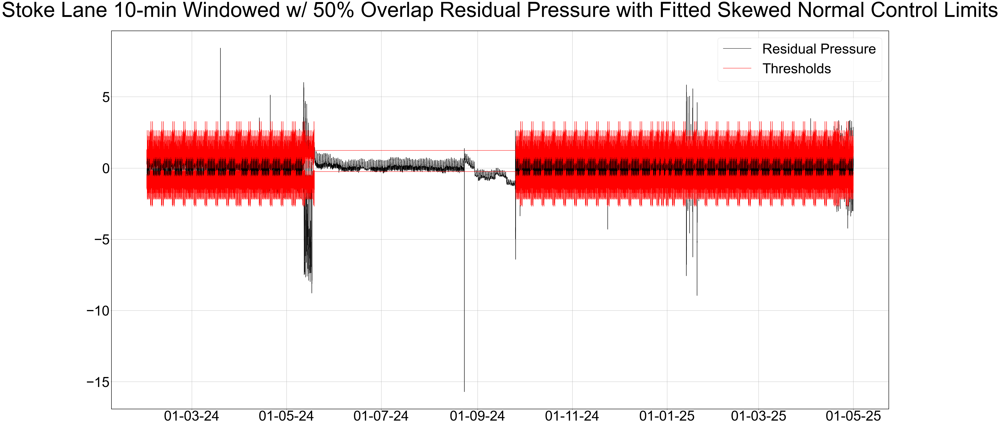

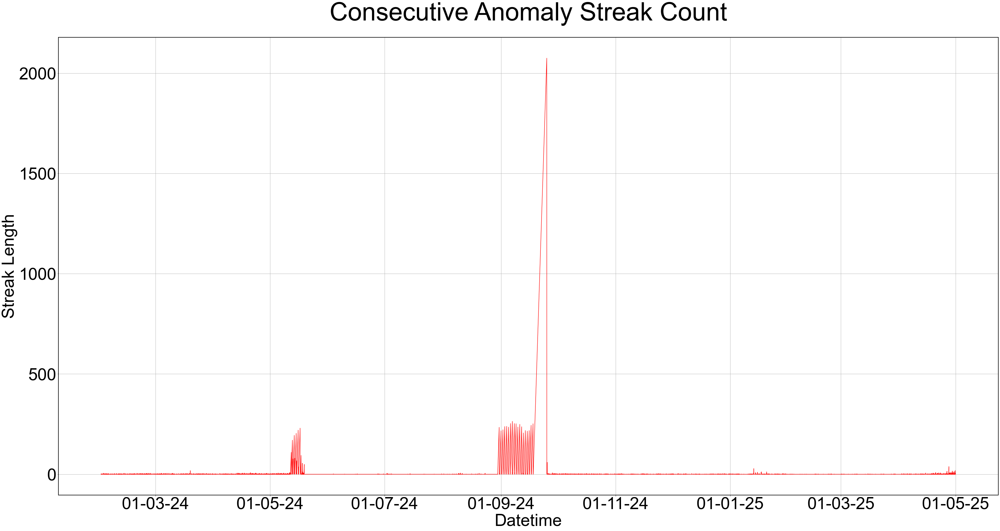

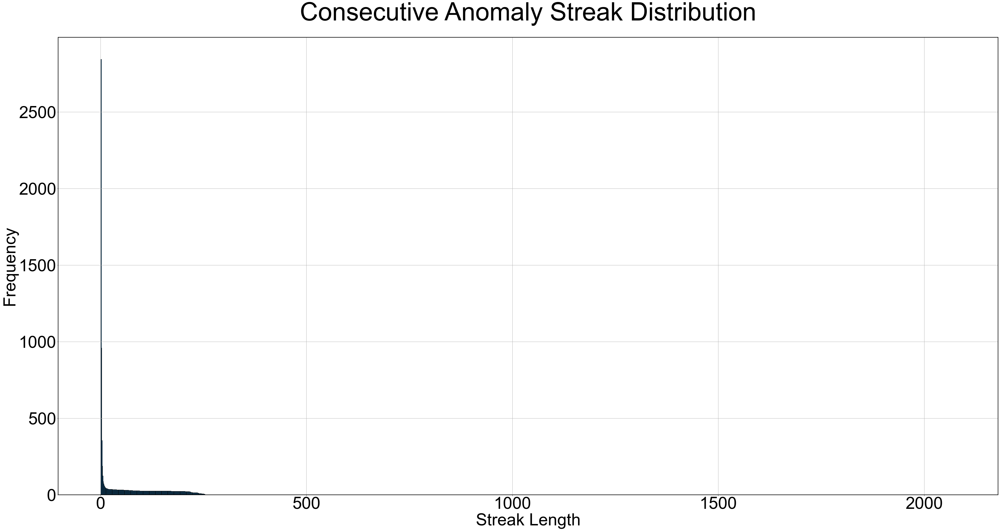

In [17]:
# ----- 0) Parameters & functions -----
value_col = Pres_str 
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}

def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Fixed outlet percentile thresholds -----
june = Pres10.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -4)
static_upper = min(static_upper,  4)
print("[3/7] Static thresholds computed.")

# ----- 3) Monthly threshold function -----
def compute_pct_thresholds(df):
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        # enforce hard bounds
        return (t, m, max(lo, -4), min(hi, 4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- 4) Initialize window & thresholds -----
window_df = Pres10.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- 5) Prepare sim_df -----
sim_df = Pres10.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- 6) Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        # drop extreme values
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- 7) Anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- 8) Finalize & plot -----
flagged_all = merged.copy()
residual10_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Residual Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r-', label='Thresholds')
ax.plot(flagged_all.index, flagged_all['lower'], 'r-')
ax.set_title(f'Stoke Lane {T10_str} Residual Pressure with Fitted Skewed Normal Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly streak count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y'))
ax2.grid(True)
plt.show()

# Histogram of streak lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

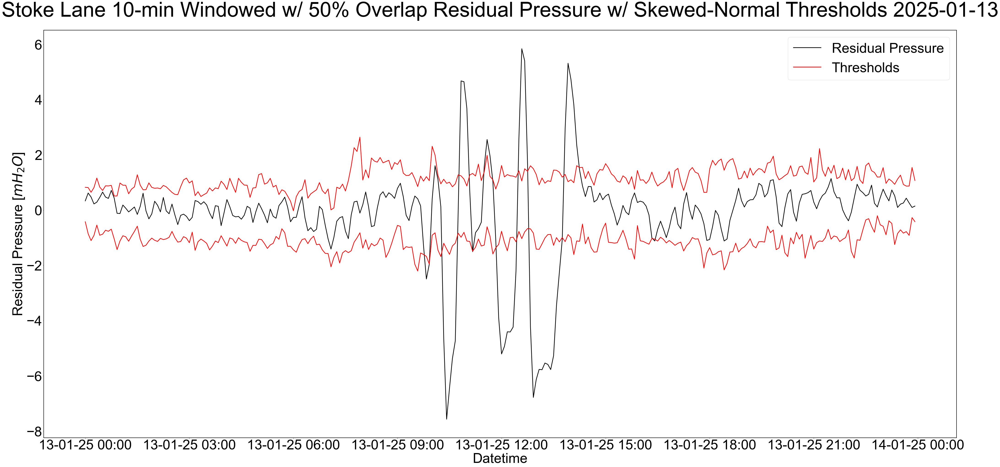

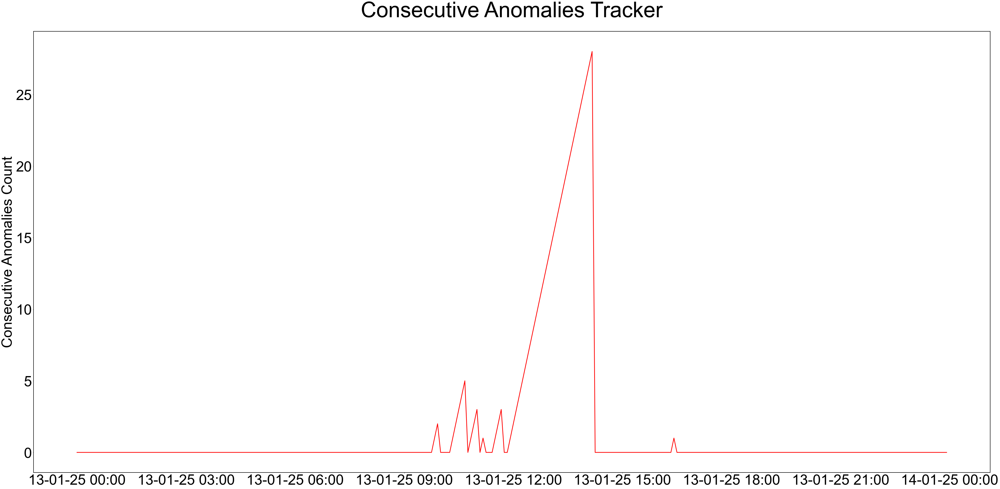

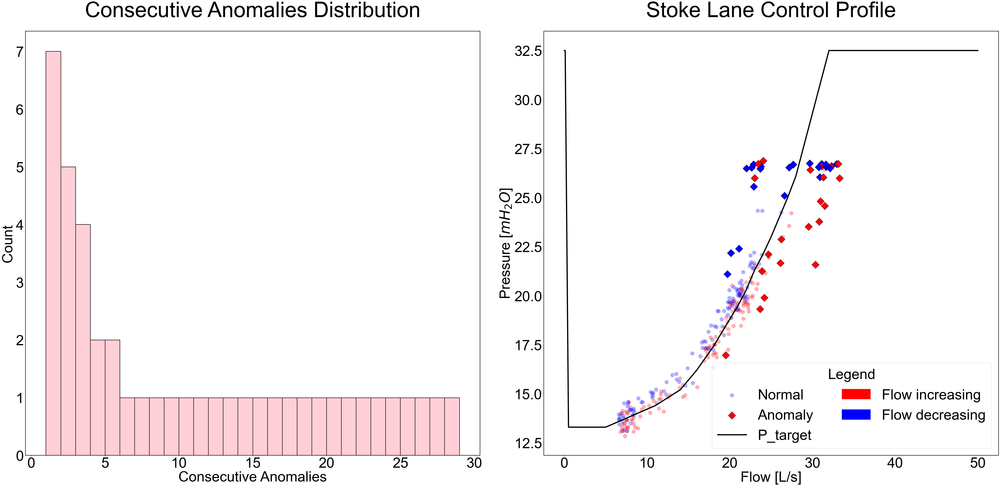

In [18]:
start, end = '2025-01-13','2025-01-13'
value_col = Pres_str
# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all[value_col].loc[start:end],
        'k-', label='Residual Pressure', linewidth = 3)
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Residual Pressure [$mH_2O$]')
ax.set_title(
    f'Stoke Lane {T10_str} Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# —  Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = residual10_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = residual10_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    residual10_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 2
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')

handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Stoke Lane Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

In [19]:
flagged_all['is_anom'] = residual10_flagged_all['count'] > 0

# Total anomaly‐minutes
total_anoms = flagged_all['is_anom'].sum()
print(f"Total anomaly-minutes: {total_anoms}")

# Daily anomaly counts
daily_counts = flagged_all['is_anom'].resample('D').sum()
print("\nAnomalies per day:")
print(daily_counts)

# Build the boolean mask of anomalous minutes
mask = flagged_all['count'] > 0

# Group into consecutive‐run IDs
grp = (mask != mask.shift(fill_value=False)).cumsum()

# Get lengths of each anomalous run (in minutes)
event_lengths = flagged_all[mask].groupby(grp).size()

# Daily anomaly‐minutes & events
daily_minutes = mask.resample('D').sum()                     
avg_minutes   = daily_minutes.mean()                         
starts        = mask & ~mask.shift(fill_value=False)
event_dates   = pd.to_datetime(flagged_all.index[starts]).normalize()
daily_events  = event_dates.value_counts().sort_index()     
avg_events    = daily_events.mean()                          

# Count events by duration
n_single   = (event_lengths == 1).sum()
n_lt5      = (event_lengths < 5).sum()
n_lt15     = (event_lengths < 15).sum()
n_lt60     = (event_lengths < 60).sum()
n_gt1440   = (event_lengths >= 60).sum() 

print(f"Avg anomaly‐minutes per day: {avg_minutes:.1f}")
print(f"Avg anomaly‐events per day:  {avg_events:.2f}\n")

print("Event duration counts:")
print(f"  single-minute events:       {n_single}")
print(f"  events <5 min:              {n_lt5}")
print(f"  events <15 min:             {n_lt15}")
print(f"  events <1 h:                {n_lt60}")
print(f"  events >1 h:              {n_gt1440}")

# Total anomaly-minutes per month
anom_min_by_month = (
    flagged_all['is_anom']
      .resample('M')
      .sum()
      .loc['2024-02-01':]  
)

month_most_min  = anom_min_by_month.idxmax().strftime('%Y-%m')
month_least_min = anom_min_by_month.idxmin().strftime('%Y-%m')

starts = (flagged_all['is_anom'] & 
          ~flagged_all['is_anom'].shift(fill_value=False))
event_month = flagged_all.index[starts].to_period('M')
anom_evt_by_month = (
    event_month
      .value_counts()
      .sort_index()
      .loc[lambda s: s.index != pd.Period('2024-01')]
)

month_most_evt  = anom_evt_by_month.idxmax().strftime('%Y-%m')
month_least_evt = anom_evt_by_month.idxmin().strftime('%Y-%m')

print(f"Most anomaly-minutes month:  {month_most_min}")
print(f"Least anomaly-minutes month: {month_least_min}")
total_events = anom_evt_by_month.sum()
print(f"Total anomaly-events (excluding Jan 2024): {total_events}")

Total anomaly-minutes: 12755

Anomalies per day:
2024-02-01    18
2024-02-02    16
2024-02-03    26
2024-02-04    29
2024-02-05     8
              ..
2025-04-26    72
2025-04-27    97
2025-04-28    49
2025-04-29    84
2025-04-30    82
Freq: D, Name: is_anom, Length: 455, dtype: int64
Avg anomaly‐minutes per day: 28.0
Avg anomaly‐events per day:  8.20

Event duration counts:
  single-minute events:       1886
  events <5 min:              2721
  events <15 min:             2804
  events <1 h:                2815
  events >1 h:              30
Most anomaly-minutes month:  2024-09
Least anomaly-minutes month: 2024-06
Total anomaly-events (excluding Jan 2024): 2845


### 2.5. Comparison of window strategies

This section provides an analysis of the flagged timestamps from each windowing strategy.

In [20]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    mask = df['count'] > 0
    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')

    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()
    avg_minutes = total_minutes / n_days

    # Daily anomaly‐events & average
    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    # Event duration counts
    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths <= 3).sum()
    n_lt15    = (event_lengths <= 6).sum()
    n_lt60    = (event_lengths <= 12).sum()
    n_gt60    = (event_lengths > 12).sum()

    # Monthly anomaly‐minutes
    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()

    # Monthly anomaly‐events
    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()
    
    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  <=5-minute:              {n_single}")
    print(f"  <15 min:                 {n_lt5-n_single}")
    print(f"  <30 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [21]:
models = {
    'Fixed 5-min residual':   residual_flagged_all,
    '10-min windows w/ 50% overlap residual': residual10_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Fixed 5-min residual ===
Total flagged minutes:    57625
Avg anomaly‐minutes/day:  118.57
Avg anomaly‐events/day:   7.87

Event duration counts:
  <=5-minute:              2246
  <15 min:                 435
  <30 min:                 54
  <1 h:                    19
  >1 h:                    41

Anomaly‐minutes by month:
  Most:  2024-09 (6172 min)
  Least: 2024-06 (26 min)

Anomaly‐events by month:
  Most:  2025-04 (483 events)
  Least: 2024-06 (24 events)
Total events:             2795

=== 10-min windows w/ 50% overlap residual ===
Total flagged minutes:    63775
Avg anomaly‐minutes/day:  131.22
Avg anomaly‐events/day:   8.20

Event duration counts:
  <=5-minute:              1886
  <15 min:                 770
  <30 min:                 117
  <1 h:                    30
  >1 h:                    42

Anomaly‐minutes by month:
  Most:  2024-09 (6407 min)
  Least: 2024-06 (17 min)

Anomaly‐events by month:
  Most:  2024-04 (399 events)
  Least: 2024-06 (12 events)
Total events

## 3. Normalised Residual Analysis

This section contains the fault detection analysis with normalised residual pressures. The analysis is carried out using 5-minute normalised residuals and 10-minute normalised resiudals with a 50% overlap.

### 3.1. Fault detecetion w/ fixed 5-minute windows

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-05-01
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-08-29
    • Fitted 576 regimes at 2024-08-29
    • Fitted 0 regimes at NaT
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-04-01
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


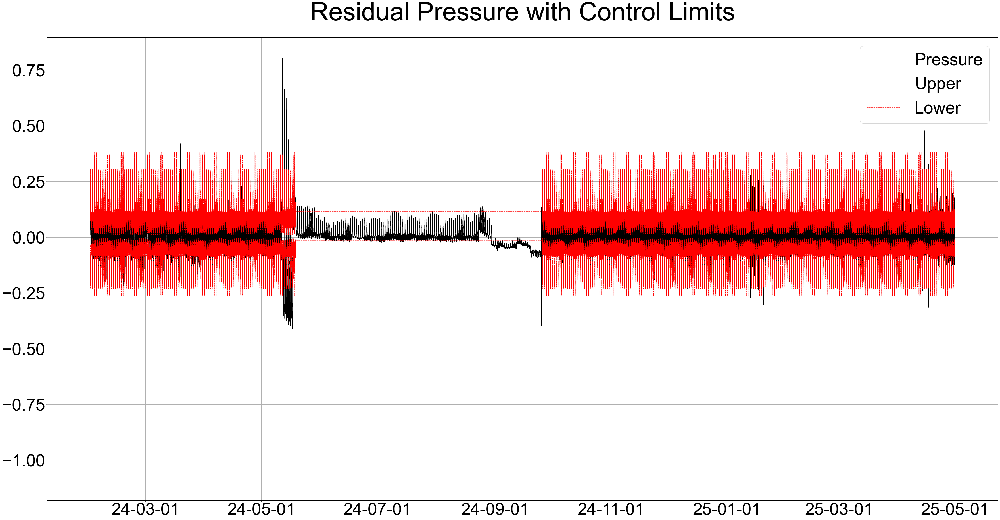

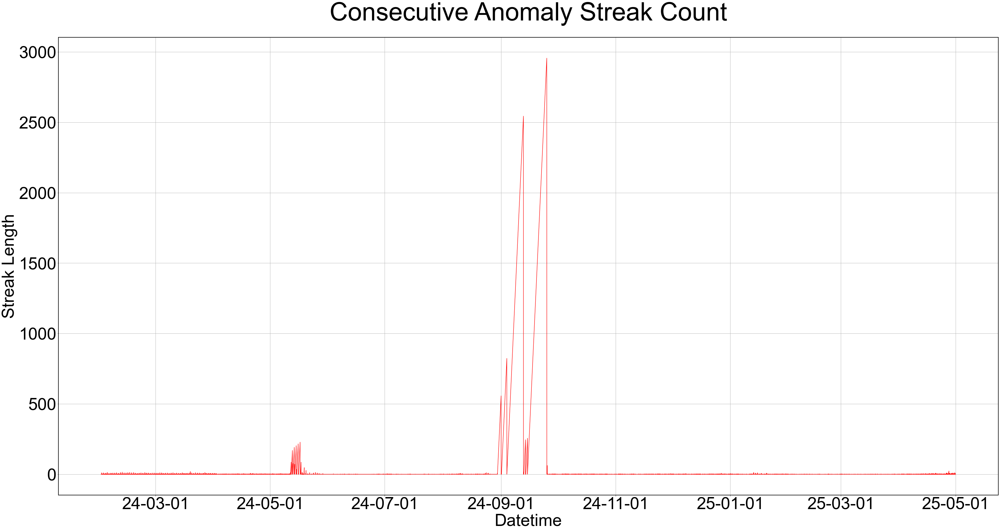

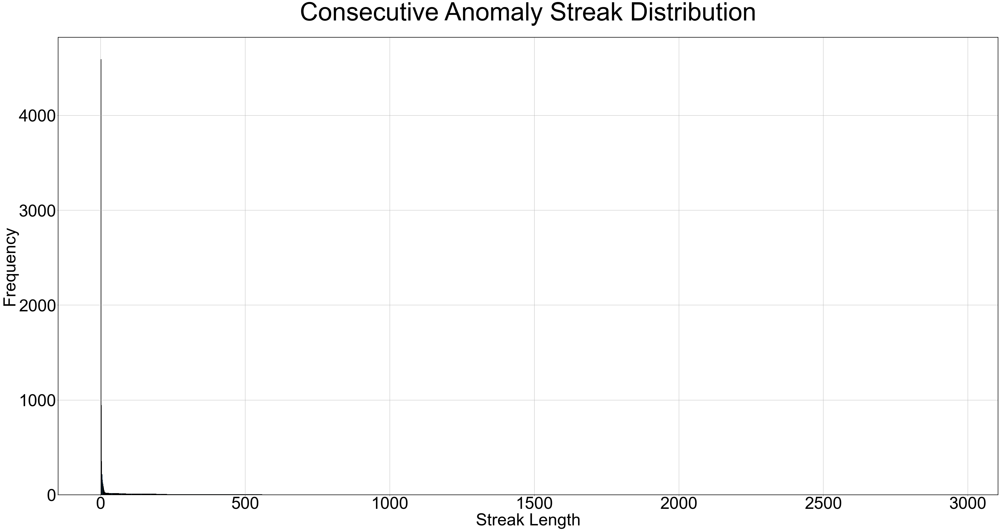

In [22]:
# ----- 0) Parameters & functions -----
value_col = Normalised_str  
P_LOW, P_HIGH = 0.01, 0.997
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Fixed outlet percentile thresholds -----
june = Normalised.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -0.4)
static_upper = min(static_upper,  0.4)
print("[3/7] Static thresholds computed.")

# ----- 3) Monthly threshold function -----
def compute_pct_thresholds(df):
    """
    Fit skewnorm & gamma per (time_5min, model), pick by AIC,
    return DataFrame with ['time_5min','model','lower','upper'].
    """
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        # enforce hard bounds
        return (t, m, max(lo, -0.4), min(hi, 0.4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- 4) Initialize window & thresholds -----
window_df = Normalised.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- 5) Prepare sim_df -----
sim_df = Normalised.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- 6) Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        # drop extreme values
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- 7) Vectorized anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- 8) Finalize & plot -----
flagged_all = merged.copy()
normalised_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly streak count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of streak lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


### 3.2. Fault detection w/ 10-minute windows w/ 50% overlap

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-05-01
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-08-29
    • Fitted 576 regimes at 2024-08-29
    • Fitted 288 regimes at 2024-10-26
    • Fitted 576 regimes at 2024-11-30
    • Fitted 576 regimes at 2024-12-30
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-04-01
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


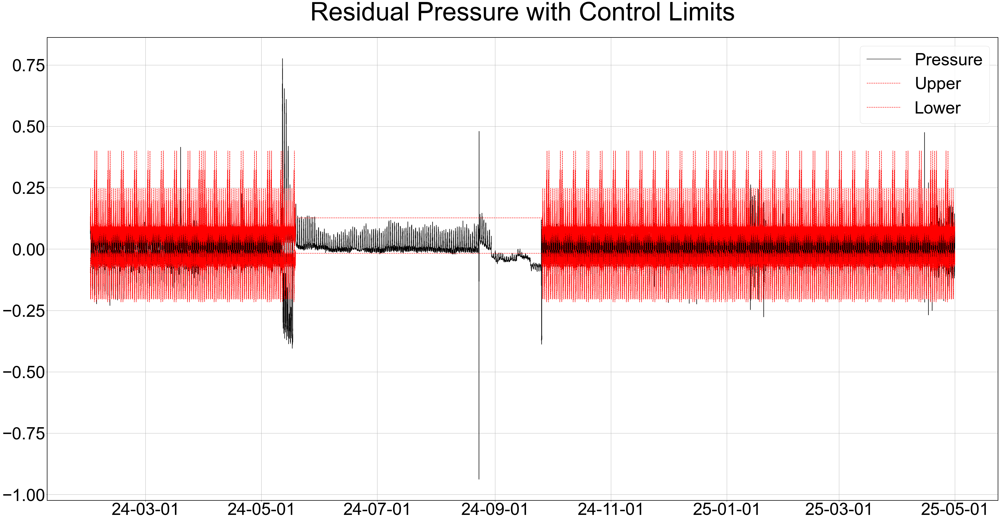

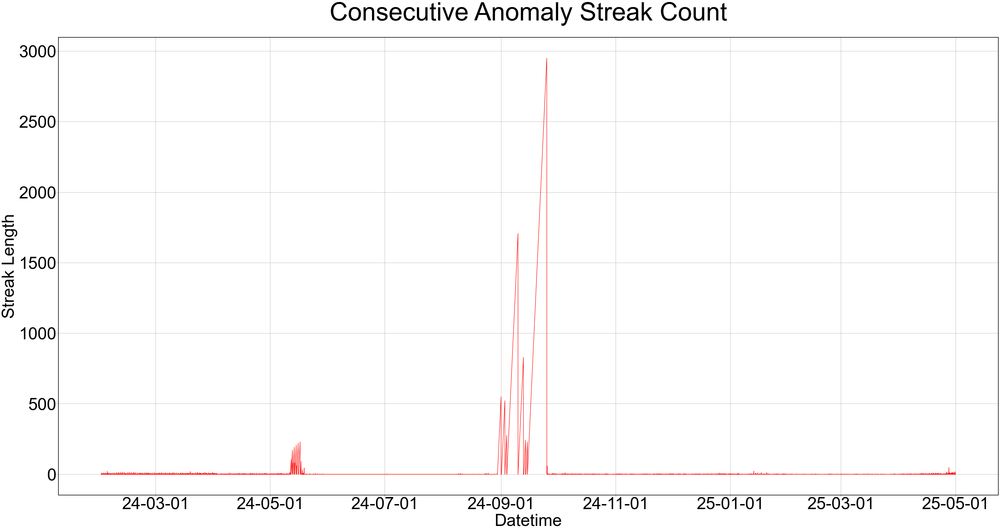

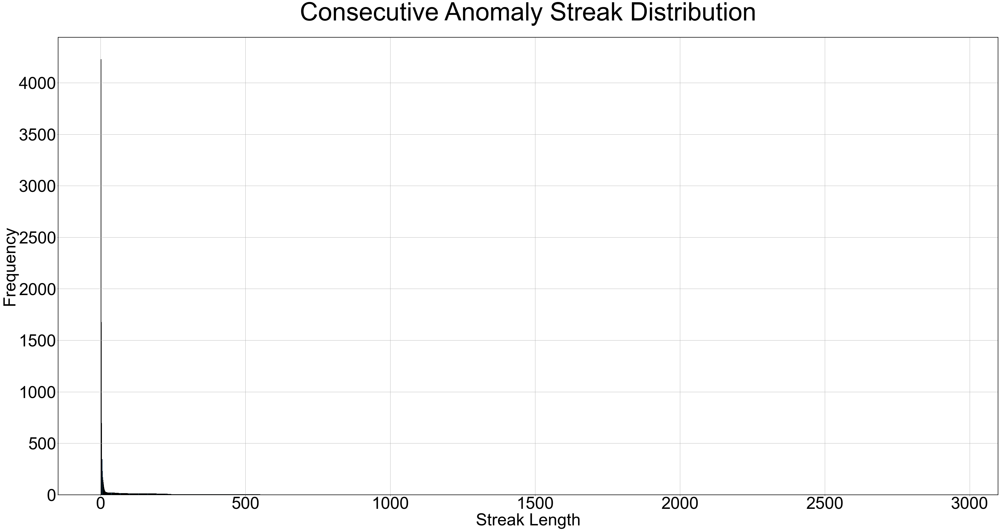

In [23]:
# ----- 0) Parameters & functions -----
value_col = Normalised_str 
P_LOW, P_HIGH = 0.01, 0.997
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Static (June) percentile thresholds -----
june = Normalised10.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
# enforce max threshold values ±4
static_lower = max(static_lower, -0.4)
static_upper = min(static_upper,  0.4)
print("[3/7] Static thresholds computed.")

# ----- 3) Parallelized monthly threshold computation -----
def compute_pct_thresholds(df):
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        # enforce hard bounds
        return (t, m, max(lo, -0.4), min(hi, 0.4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- 4) Initialize window & thresholds -----
window_df = Normalised10.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- 5) Prepare sim_df -----
sim_df = Normalised10.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- 6) Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        # drop extreme values
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- 7) Vectorized anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- 8) Finalize & plot -----
flagged_all = merged.copy()
normalised10_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly streak count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of streak lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


### 3.3. Fault control plots

The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

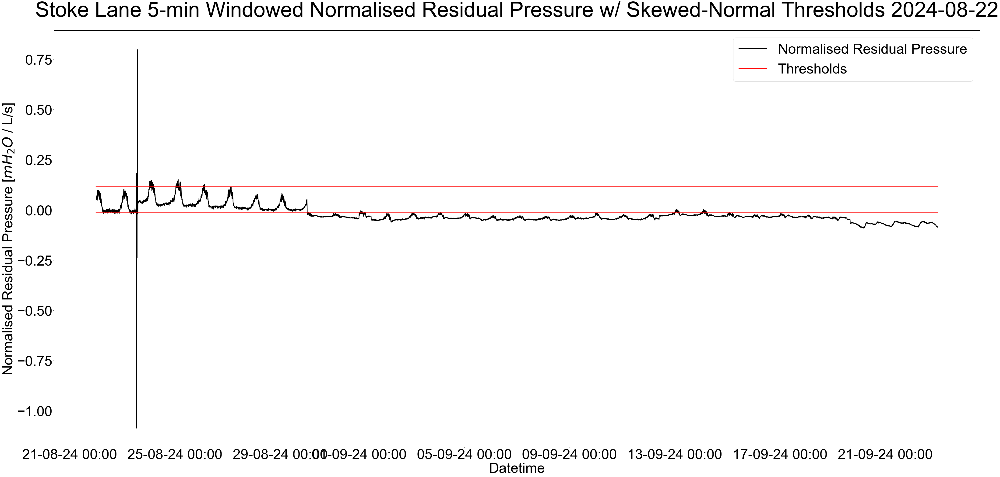

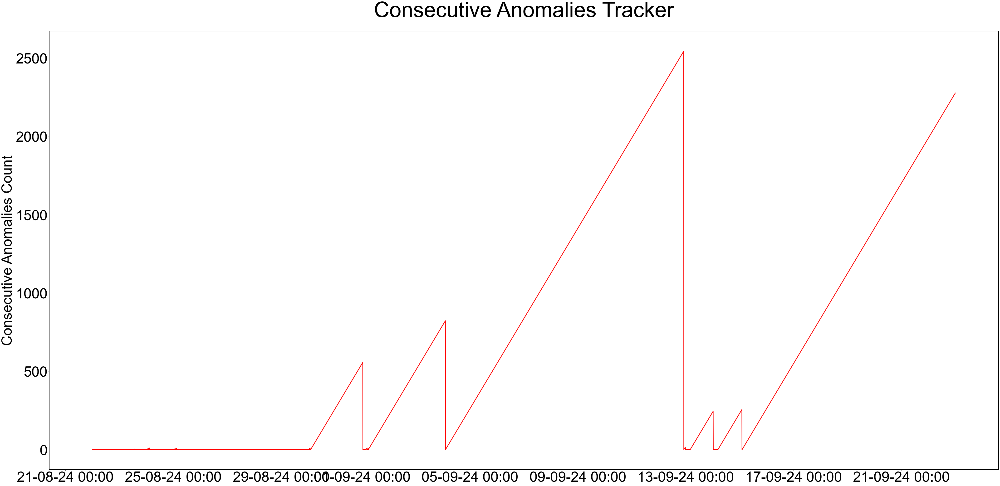

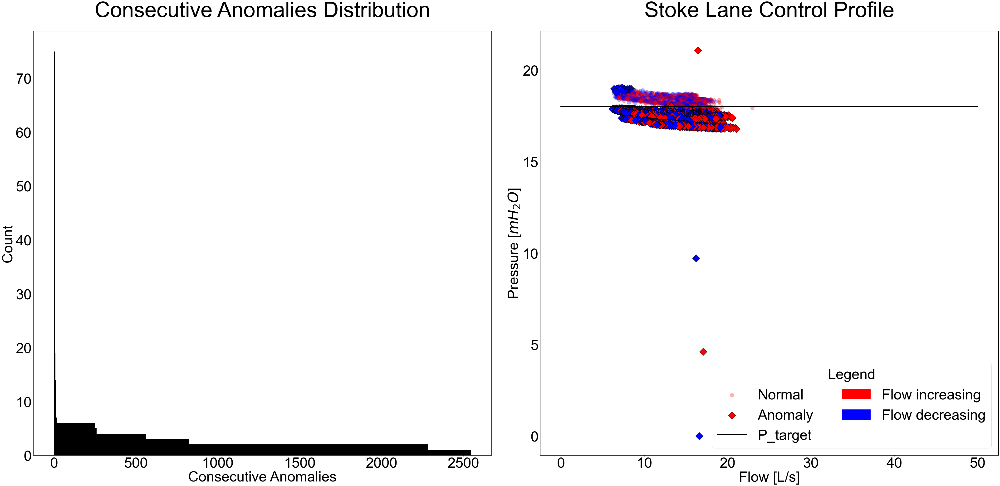

In [24]:
start, end = '2024-08-22','2024-09-22'
value_col = Normalised_str
# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all[value_col].loc[start:end],
        'k-', label='Normalised Residual Pressure', linewidth = 3)
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Normalised Residual Pressure [$mH_2O$ / L/s]')
ax.set_title(
    f'Stoke Lane {T_str} Normalised Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# — Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = normalised_flagged_all['count'].loc[start:end]

# Prepare flow & residual data
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]

floored        = flow_plot.index.floor('5T')
counts_on_flow = normalised_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0

days_with_anomalies = (
    normalised_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 3
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')

handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Stoke Lane Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

### 3.4. Comparison of window strategies

This section provides an analysis of the flagged timestamps from each windowing strategy. A comparison between flagged anomalies from the residual and normalised residual analysis is also provided below

In [25]:
models = {
    'Fixed 5-min residual':   normalised_flagged_all,
    '10-min windows w/ 50% overlap residual': normalised10_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Fixed 5-min residual ===
Total flagged minutes:    77485
Avg anomaly‐minutes/day:  159.43
Avg anomaly‐events/day:   11.51

Event duration counts:
  <=5-minute:              3648
  <15 min:                 731
  <30 min:                 101
  <1 h:                    84
  >1 h:                    29

Anomaly‐minutes by month:
  Most:  2024-09 (7022 min)
  Least: 2024-06 (61 min)

Anomaly‐events by month:
  Most:  2025-04 (713 events)
  Least: 2024-06 (56 events)
Total events:             4593

=== 10-min windows w/ 50% overlap residual ===
Total flagged minutes:    83210
Avg anomaly‐minutes/day:  171.21
Avg anomaly‐events/day:   12.33

Event duration counts:
  <=5-minute:              2553
  <15 min:                 1331
  <30 min:                 201
  <1 h:                    101
  >1 h:                    44

Anomaly‐minutes by month:
  Most:  2024-09 (6985 min)
  Least: 2024-06 (0 min)

Anomaly‐events by month:
  Most:  2024-03 (723 events)
  Least: 2024-07 (4 events)
Total eve

In [26]:
models = {
    'Residual':   residual_flagged_all,
    'Normalised Residual': normalised_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Residual ===
Total flagged minutes:    57625
Avg anomaly‐minutes/day:  118.57
Avg anomaly‐events/day:   7.87

Event duration counts:
  <=5-minute:              2246
  <15 min:                 435
  <30 min:                 54
  <1 h:                    19
  >1 h:                    41

Anomaly‐minutes by month:
  Most:  2024-09 (6172 min)
  Least: 2024-06 (26 min)

Anomaly‐events by month:
  Most:  2025-04 (483 events)
  Least: 2024-06 (24 events)
Total events:             2795

=== Normalised Residual ===
Total flagged minutes:    77485
Avg anomaly‐minutes/day:  159.43
Avg anomaly‐events/day:   11.51

Event duration counts:
  <=5-minute:              3648
  <15 min:                 731
  <30 min:                 101
  <1 h:                    84
  >1 h:                    29

Anomaly‐minutes by month:
  Most:  2024-09 (7022 min)
  Least: 2024-06 (61 min)

Anomaly‐events by month:
  Most:  2025-04 (713 events)
  Least: 2024-06 (56 events)
Total events:             4593


## 4. CV Analysis

The following section provides code for the CV analysis. 4.1 to 4.3 apply the analysis to flow, outlet pressure, and inlet pressure with IQR thresholds whilst 4.4 to 4.7 apply the analysis with fitted distributions.

### 4.1. Flow CV w/ IQR Thresholds

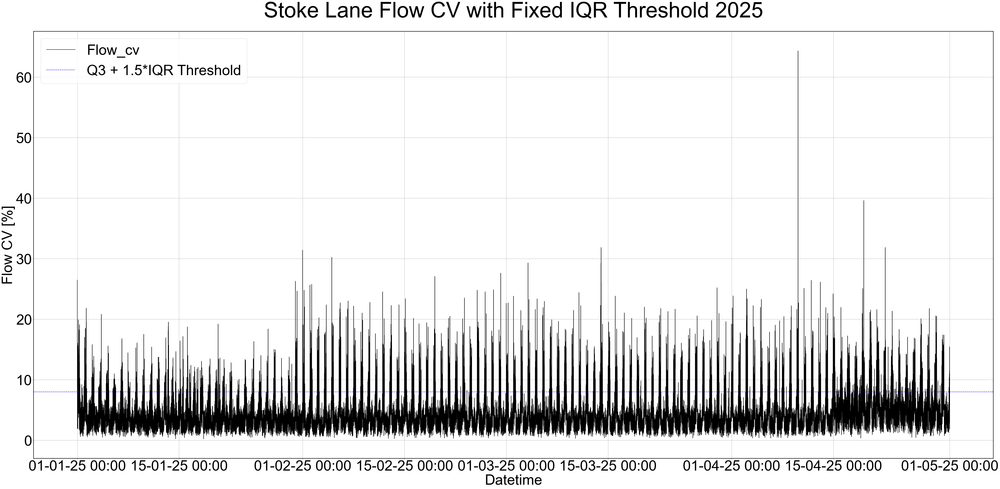

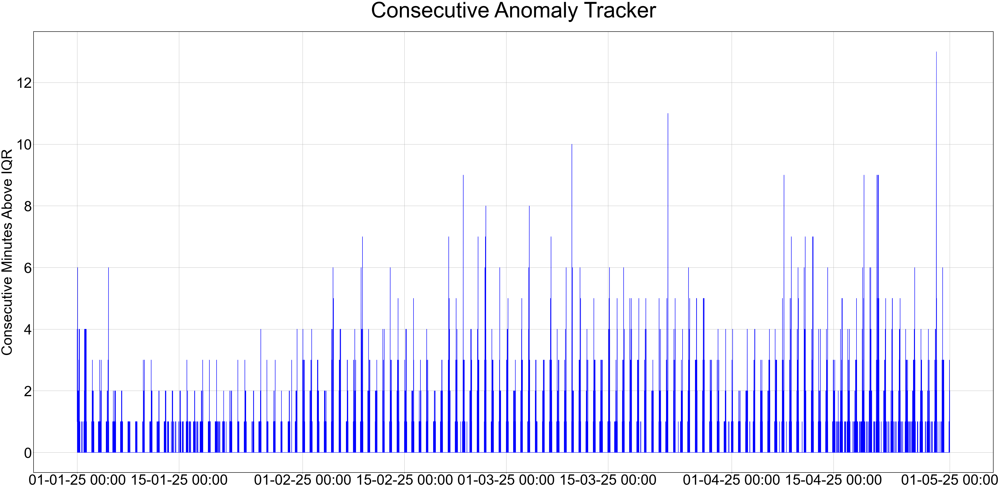

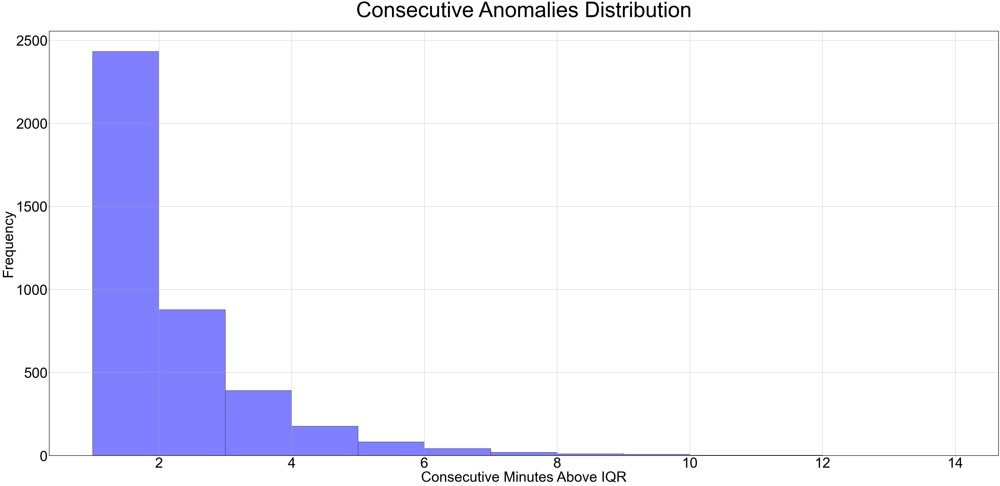

            max_iq
date              
2024-01-01       5
2024-01-02       1
2024-01-03       1
2024-01-04       2
2024-01-05       3
...            ...
2025-04-26       6
2025-04-27       4
2025-04-28       4
2025-04-29      13
2025-04-30       6

[486 rows x 1 columns]


In [27]:
value_col = Flow_cv_str
calib    = Flow_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr

sim_df    = Flow_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )
    
    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Flow_cv_flagged_all = pd.concat(flagged_days)


# Time series with IQR fence
start, end = '2025', '2025'

data = Flow_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Stoke Lane Flow CV with Fixed IQR Threshold {start}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.set_title('Consecutive Anomaly Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomalies lengths
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, ax=ax)
ax.set_title(f'Consecutive Anomalies Distribution')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

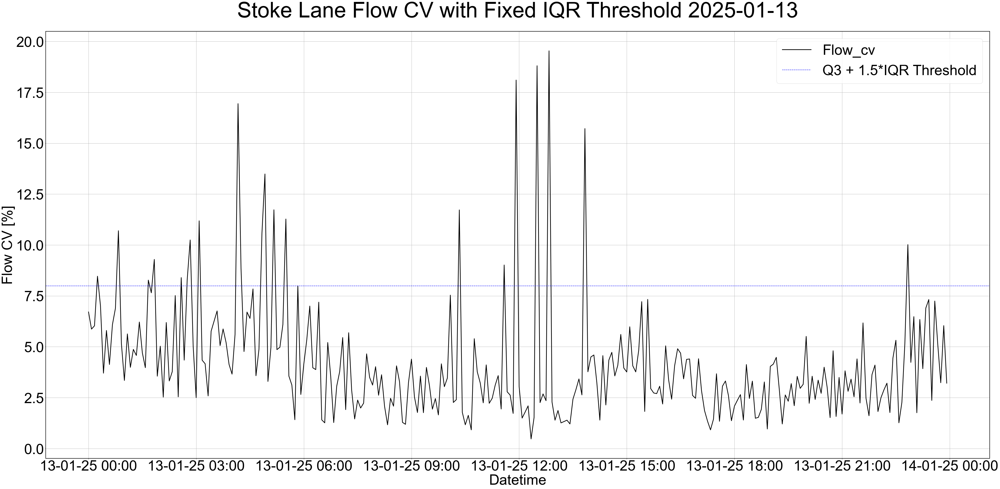

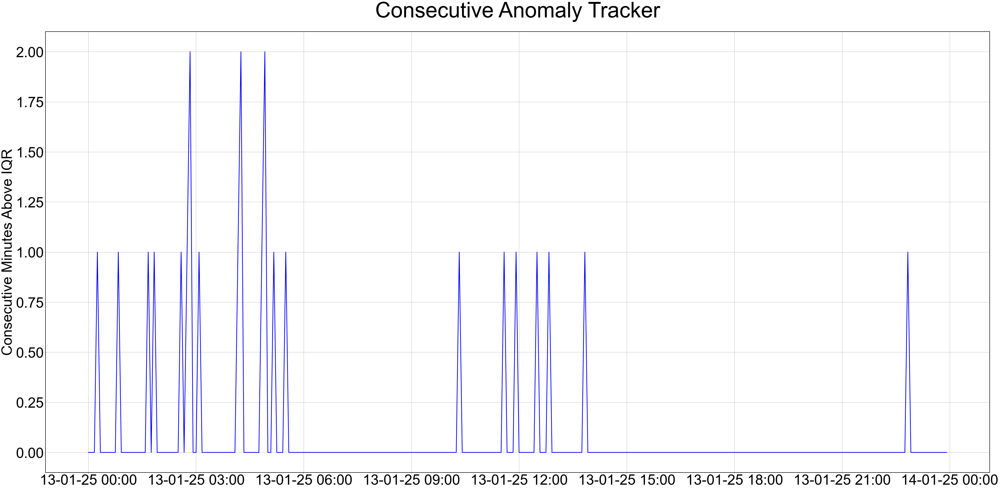

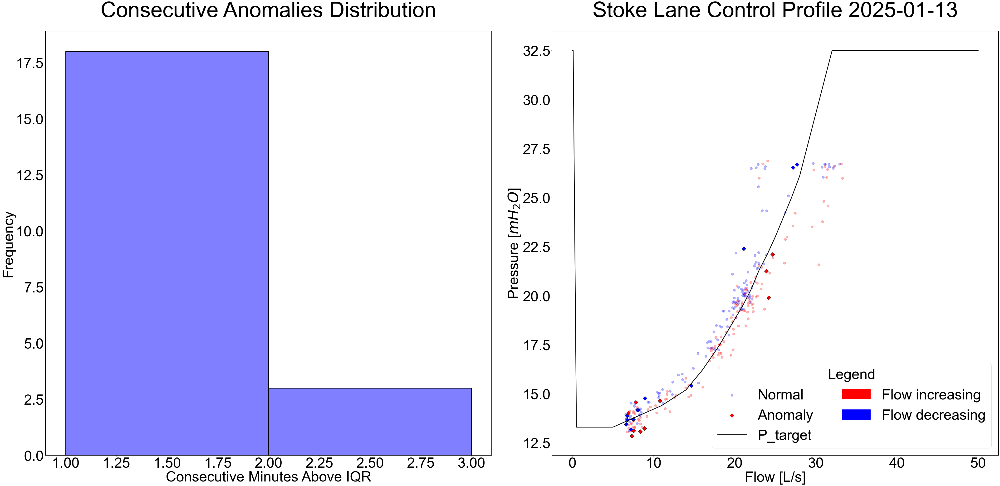

            max_iq
date              
2024-01-01       5
2024-01-02       1
2024-01-03       1
2024-01-04       2
2024-01-05       3
...            ...
2025-04-26       6
2025-04-27       4
2025-04-28       4
2025-04-29      13
2025-04-30       6

[486 rows x 1 columns]


In [28]:
start, end = '2025-01-13', '2025-01-13'
data = Flow_cv_flagged_all.loc[start:end]

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col, linewidth = 3)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Stoke Lane Flow CV with Fixed IQR Threshold {start}')
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', linewidth = 3)
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_title('Consecutive Anomaly Tracker')
ax.grid(True)
plt.tight_layout()
plt.show()

# Anomalies distribution + Control Profile subplot
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0

flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = Flow_cv_flagged_all['cv_count_iq'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0

days_with_anomalies = (
    Flow_cv_flagged_all.loc[start:end]
    .query('cv_count_iq > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)
sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5, linewidth = 3)
ax_hist.set_title('Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Minutes Above IQR')
ax_hist.set_ylabel('Frequency')

sc_norm = ax_ctrl.scatter(
    flow_plot[~anomaly_mask],
    pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=100, alpha=0.3, label='Normal'
)
sc_anom = ax_ctrl.scatter(
    flow_plot[anomaly_mask],
    pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=150, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_ctrl.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=3, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')

handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_ctrl.legend(handles=handles, labels=labels,
               loc='lower right', ncol=2, title='Legend')

ax_ctrl.set(
    title=f"Stoke Lane Control Profile {start}",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

print(summary_df)

In [29]:
# start, end = '2024-02-14','2024-02-14'
# data = Flow_cv_flagged_all.loc[start:end]

# fig, ax = plt.subplots()
# ax.plot(data.index, data[value_col], 'k-', label=value_col)
# ax.axhline(upper_iq, color='b', linestyle='--', label='IQR')
# ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
# fig.autofmt_xdate(rotation=45)
# ax.set_xlabel('Datetime')
# ax.set_ylabel('Flow CV [%]')
# ax.set_title(f'Stoke Lane Flow CV with Fixed IQR Thresholds {start} : {end}')
# ax.legend()
# ax.grid(True)
# plt.tight_layout()
# plt.show()


### 4.2. Outlet Pressure CV w/ IQR Thresholds

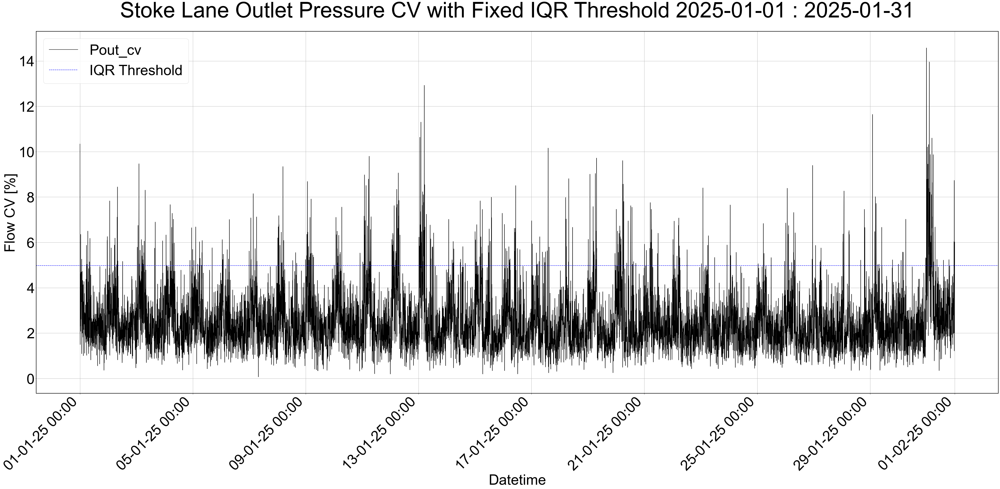

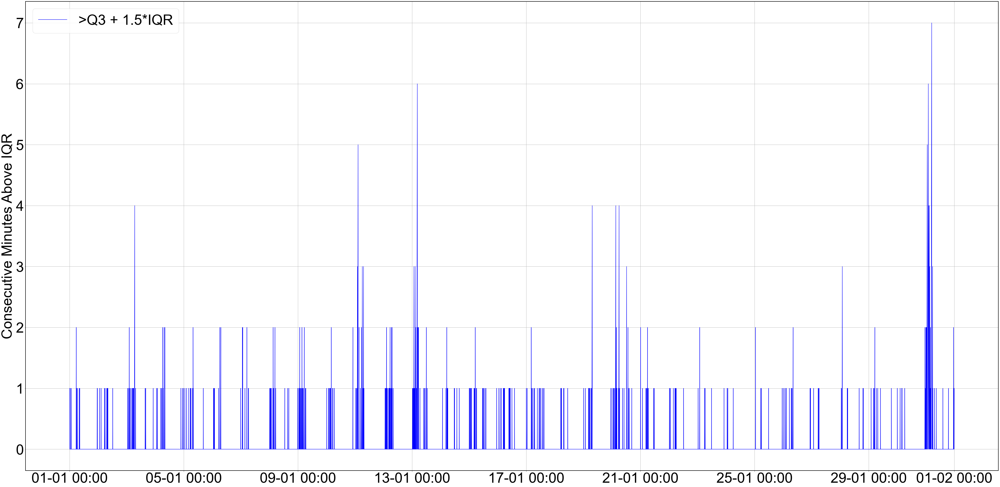

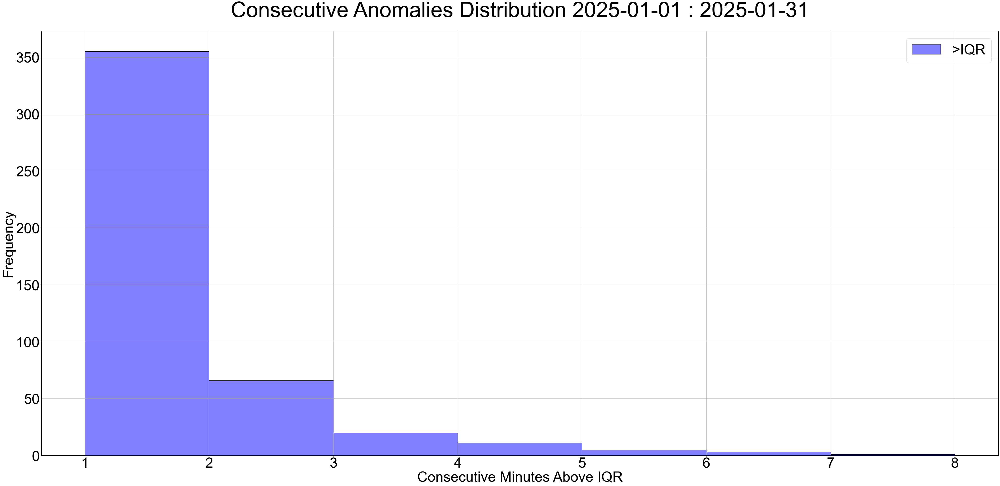

            max_iq
date              
2024-01-01       1
2024-01-02       1
2024-01-03       1
2024-01-04       2
2024-01-05       2
...            ...
2025-04-26       1
2025-04-27       2
2025-04-28       3
2025-04-29       3
2025-04-30       2

[486 rows x 1 columns]


In [30]:
value_col = Pout_cv_str
calib     = Pout_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr

sim_df    = Pout_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )
    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Pout_cv_flagged_all = pd.concat(flagged_days)


# Time series with IQR fence
start, end = '2025-01-01', '2025-01-31'
data = Pout_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='IQR Threshold')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Stoke Lane Outlet Pressure CV with Fixed IQR Threshold {start} : {end}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', label='>Q3 + 1.5*IQR')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomalies
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, label='>IQR', ax=ax)
ax.set_title(f'Consecutive Anomalies Distribution {start} : {end}')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

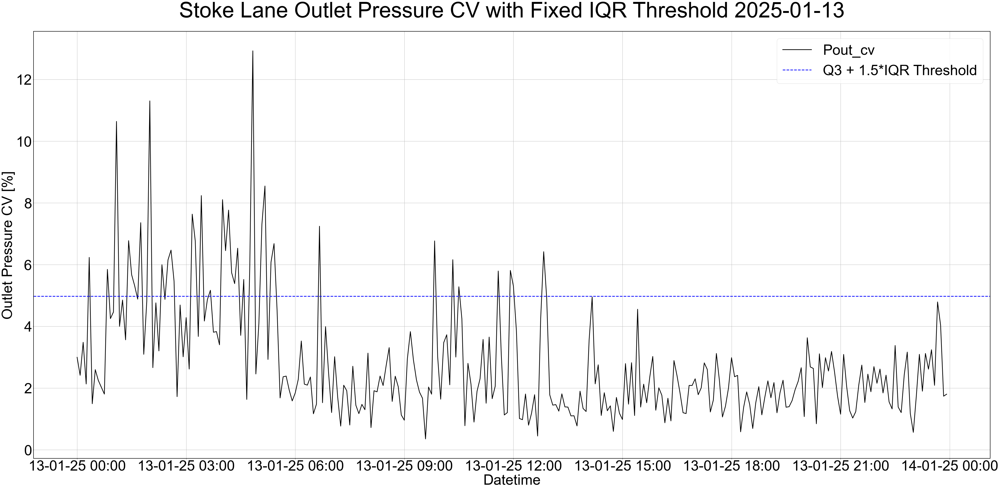

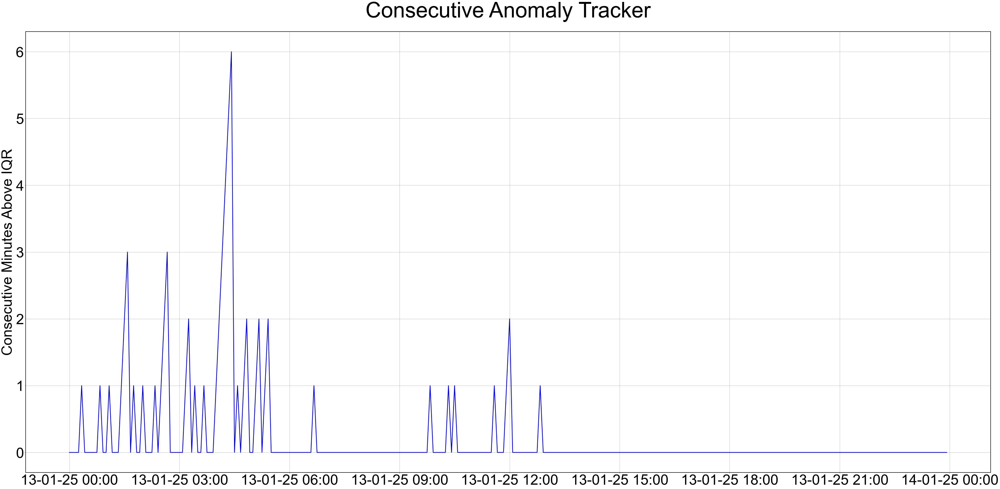

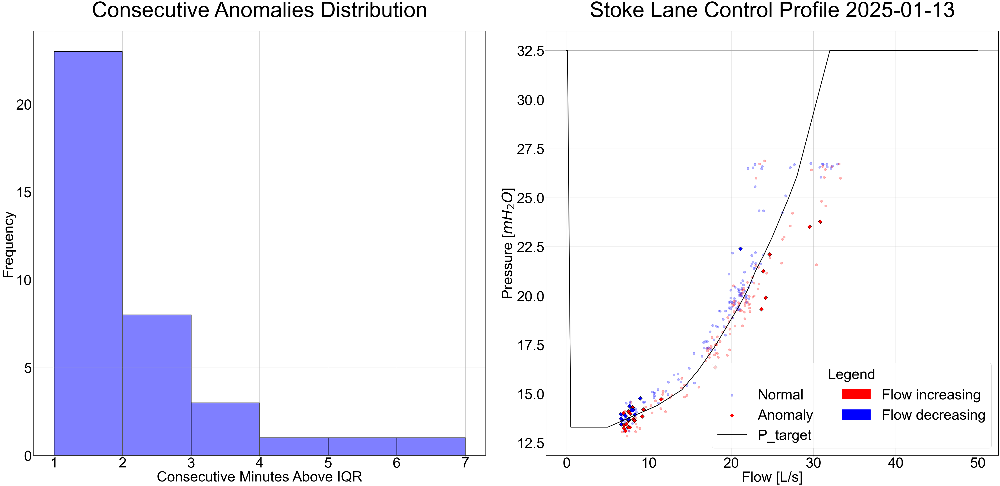

            max_iq
date              
2024-01-01       1
2024-01-02       1
2024-01-03       1
2024-01-04       2
2024-01-05       2
...            ...
2025-04-26       1
2025-04-27       2
2025-04-28       3
2025-04-29       3
2025-04-30       2

[486 rows x 1 columns]


In [31]:
# Time series with IQR fence
start, end = '2025-01-13', '2025-01-13'
data = Pout_cv_flagged_all.loc[start:end]

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col, linewidth = 3)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime')
ax.set_ylabel('Outlet Pressure CV [%]')
ax.set_title(f'Stoke Lane Outlet Pressure CV with Fixed IQR Threshold {start}')
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', linewidth = 3)
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_title('Consecutive Anomaly Tracker')
ax.grid(True)
plt.tight_layout()
plt.show()

# Distribution + Control Profile subplot
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = data['cv_count_iq'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    data.loc[start:end]
    .query('cv_count_iq > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)
sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5, linewidth = 3)
ax_hist.set_title('Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Minutes Above IQR')
ax_hist.set_ylabel('Frequency')
ax_hist.grid(True)

sc_norm = ax_ctrl.scatter(
    flow_plot[~anomaly_mask],
    pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=100, alpha=0.3, label='Normal'
)
sc_anom = ax_ctrl.scatter(
    flow_plot[anomaly_mask],
    pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=150, label='Anomaly'
)
ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_ctrl.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=3, color='black', label='P_target'
    )
    
red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_ctrl.legend(handles=handles, labels=labels,
               loc='lower right', ncol=2, title='Legend')
ax_ctrl.set(
    title=f"Stoke Lane Control Profile {start}",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)
ax_ctrl.grid(True)
plt.tight_layout()
plt.show()

print(summary_df)

### 4.3. Inlet Pressure CV w/ IQR Thresholds

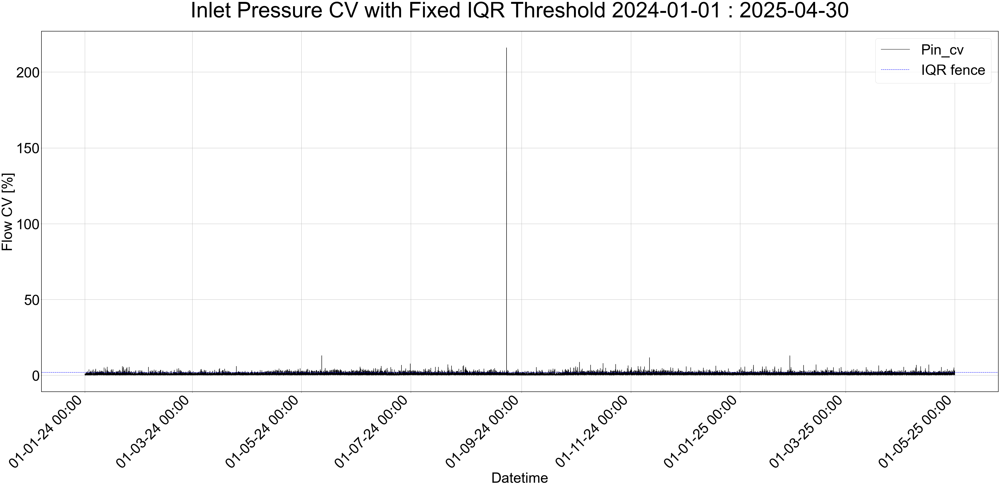

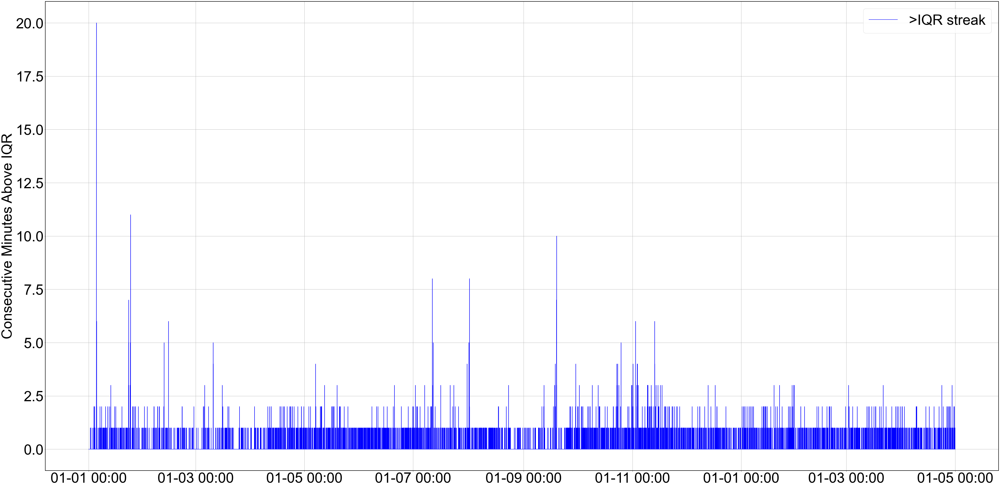

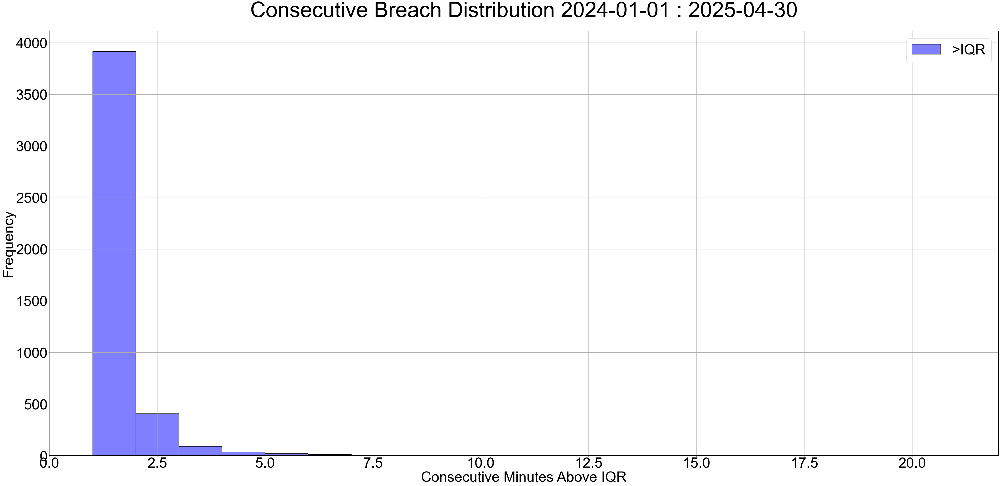

            max_iq
date              
2024-01-01       1
2024-01-02       1
2024-01-03       2
2024-01-04       2
2024-01-05      20
...            ...
2025-04-26       2
2025-04-27       2
2025-04-28       2
2025-04-29       3
2025-04-30       2

[486 rows x 1 columns]


In [32]:
value_col = Pin_cv_str
calib     = Pin_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr

sim_df    = Pin_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []
for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )
    
    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )

    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Pin_cv_flagged_all = pd.concat(flagged_days)


# Time series with IQR fence
start, end = sim_start, sim_end
data = Pin_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='IQR fence')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Inlet Pressure CV with Fixed IQR Threshold {start} : {end}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', label='>IQR streak')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomalies
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, label='>IQR', ax=ax)
ax.set_title(f'Consecutive Breach Distribution {start} : {end}')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

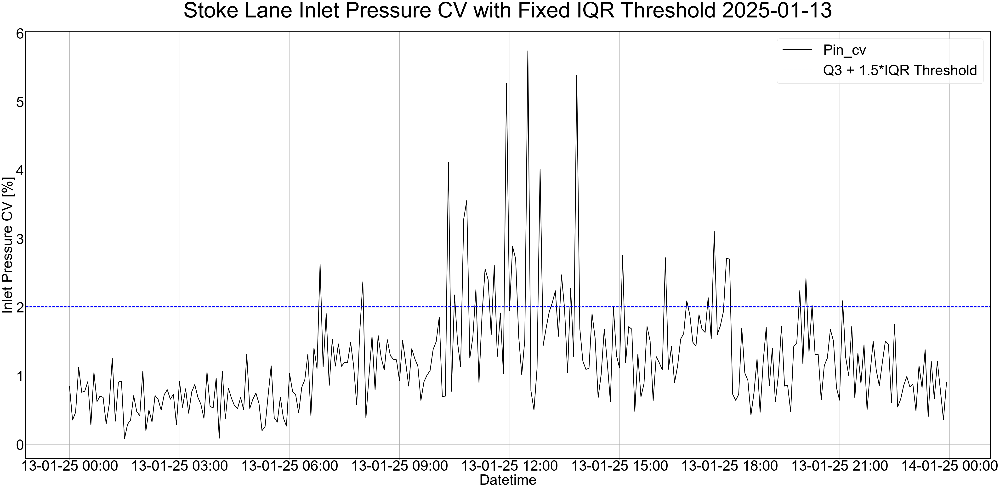

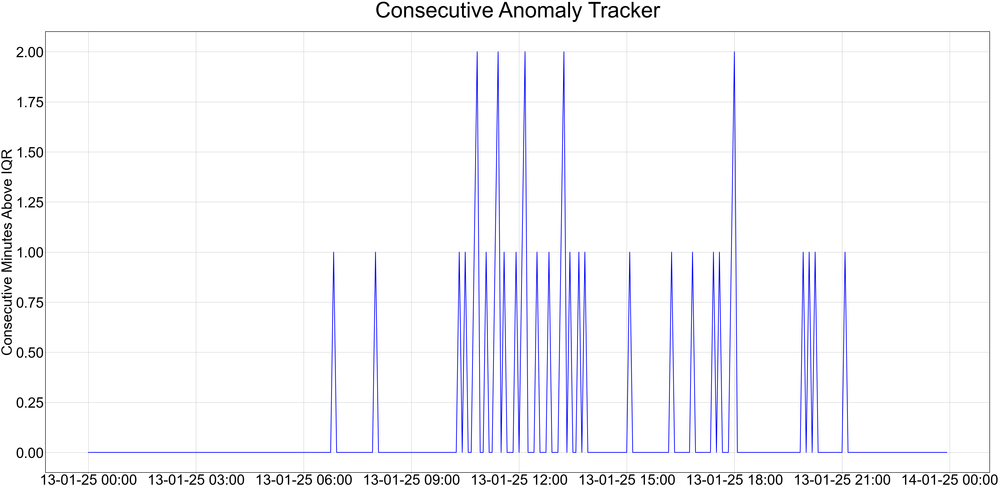

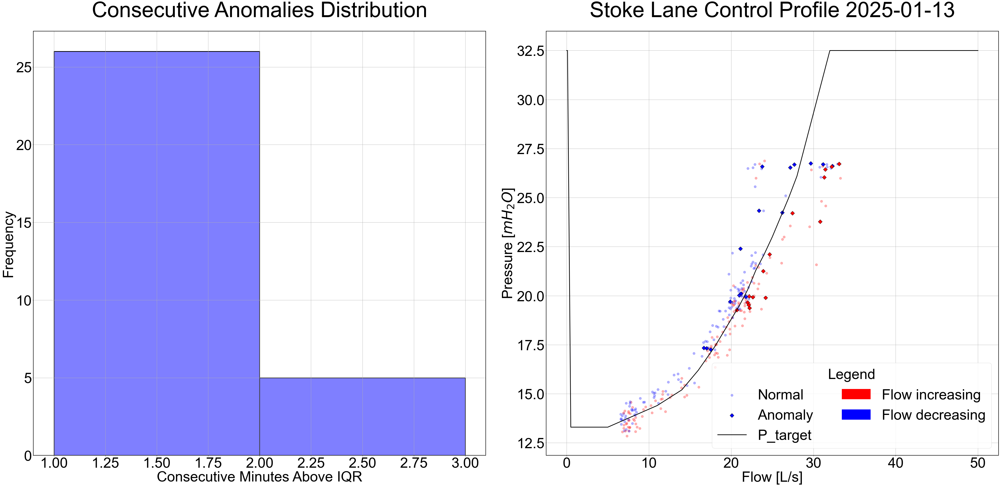

            max_iq
date              
2024-01-01       1
2024-01-02       1
2024-01-03       2
2024-01-04       2
2024-01-05      20
...            ...
2025-04-26       2
2025-04-27       2
2025-04-28       2
2025-04-29       3
2025-04-30       2

[486 rows x 1 columns]


In [33]:
# Time series with IQR fence
start, end = '2025-01-13', '2025-01-13'
data = Pin_cv_flagged_all.loc[start:end]

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col, linewidth = 3)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime')
ax.set_ylabel('Inlet Pressure CV [%]')
ax.set_title(f'Stoke Lane Inlet Pressure CV with Fixed IQR Threshold {start}')
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', linewidth = 3)
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_title('Consecutive Anomaly Tracker')
ax.grid(True)
plt.tight_layout()
plt.show()

# Anomalies distribution + Control Profile subplot
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = data['cv_count_iq'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    data.loc[start:end]
    .query('cv_count_iq > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)

sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5, linewidth = 3)
ax_hist.set_title('Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Minutes Above IQR')
ax_hist.set_ylabel('Frequency')
ax_hist.grid(True)

sc_norm = ax_ctrl.scatter(
    flow_plot[~anomaly_mask],
    pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=100, alpha=0.3, label='Normal'
)
sc_anom = ax_ctrl.scatter(
    flow_plot[anomaly_mask],
    pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=150, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_ctrl.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=3, color='black', label='P_target'
    )


red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_ctrl.legend(handles=handles, labels=labels,
               loc='lower right', ncol=2, title='Legend')

ax_ctrl.set(
    title=f"Stoke Lane Control Profile {start}",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)
ax_ctrl.grid(True)
plt.tight_layout()
plt.show()

print(summary_df)

### 4.4. Flow CV w/ 99.7% SN Thresholds

Best fit by AIC: skew-normal (AIC_sn=586953.6, AIC_g=666883.0)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'skew-normal' → 99.7th percentile = 12.030


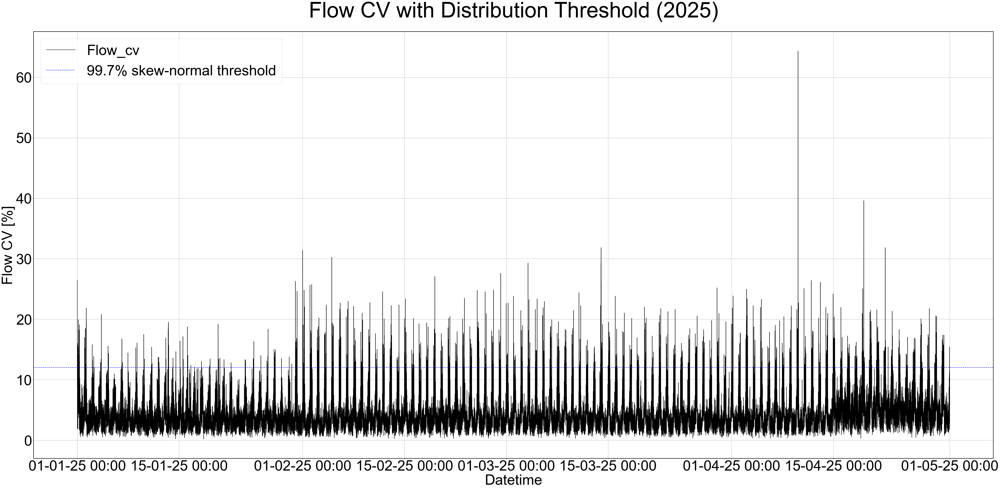

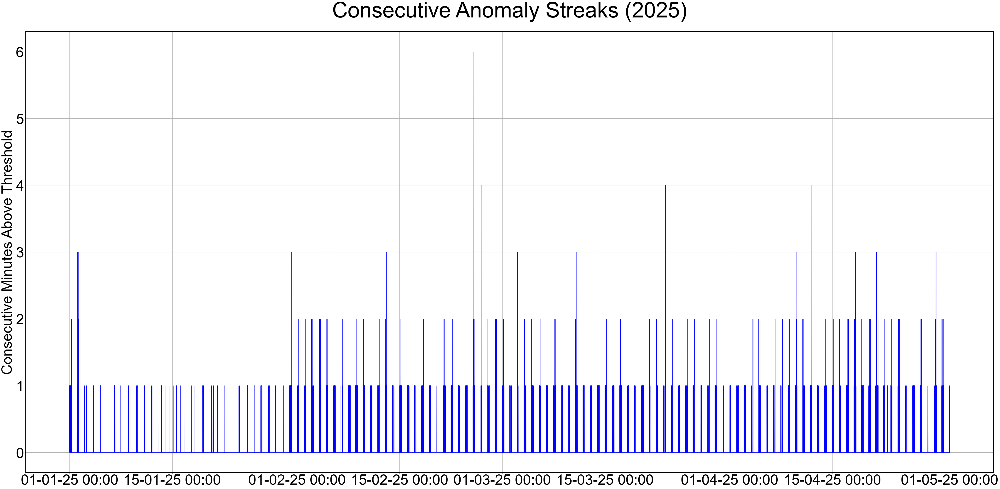

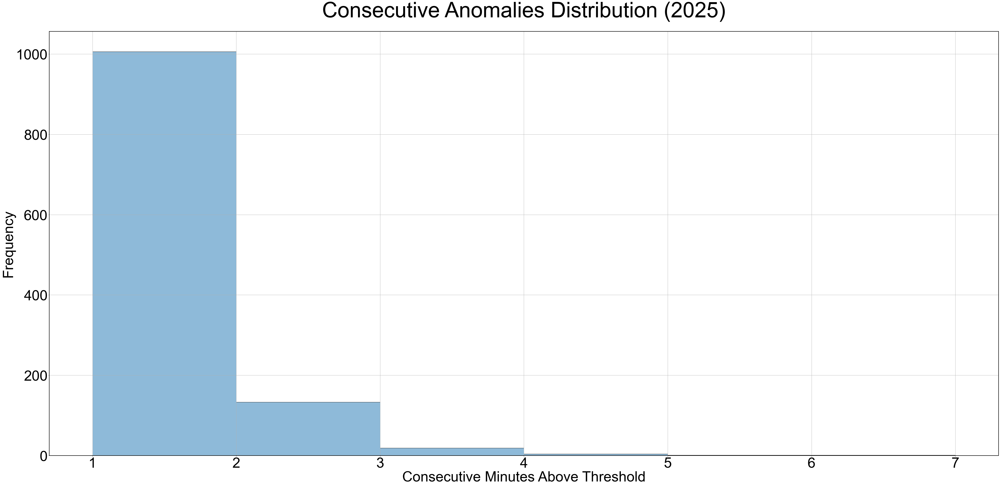

            max_dist
date                
2024-01-01         0
2024-01-02         0
2024-01-03         0
2024-01-04         1
2024-01-05         0
...              ...
2025-04-26         1
2025-04-27         2
2025-04-28         2
2025-04-29         3
2025-04-30         2

[486 rows x 1 columns]


In [34]:
value_col = Flow_cv_str

x = Flow_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)

def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Flow_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )
    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)
summary_df          = pd.DataFrame(results).set_index('date')
Flow_cv_flagged_all_SN = pd.concat(flagged_days)

data = Flow_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Flow CV [%]')
plt.title('Flow CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomalies
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()


print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

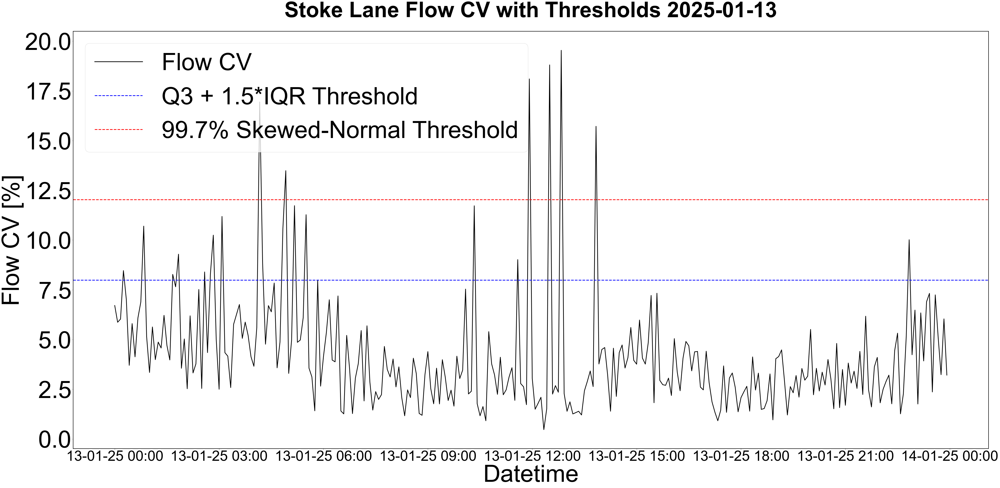

In [35]:
start, end = '2025-01-13', '2025-01-13'
data = Flow_cv_flagged_all_SN.loc[start:end]
IQRT = Flow_cv_flagged_all['cv_upper_iq'][0]
SNT = Flow_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Flow_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label='Flow CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Skewed-Normal Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime', fontsize = 100)
ax.set_ylabel('Flow CV [%]', fontsize = 100)
ax.set_title(f'Stoke Lane Flow CV with Thresholds {start}', fontweight = 'bold')
ax.legend( fontsize = 100)
plt.xticks(fontsize=60)
plt.yticks(fontsize=100)
plt.tight_layout()
plt.show()

### 4.5. Outlet Pressure CV w/ 99.7% SN Thresholds

Best fit by AIC: skew-normal (AIC_sn=455238.8, AIC_g=1861491.5)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'skew-normal' → 99.7th percentile = 7.321


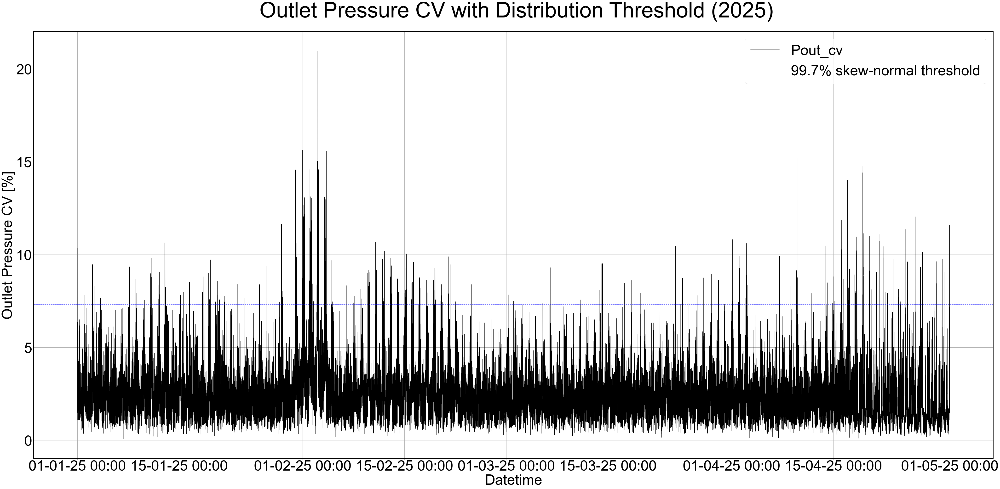

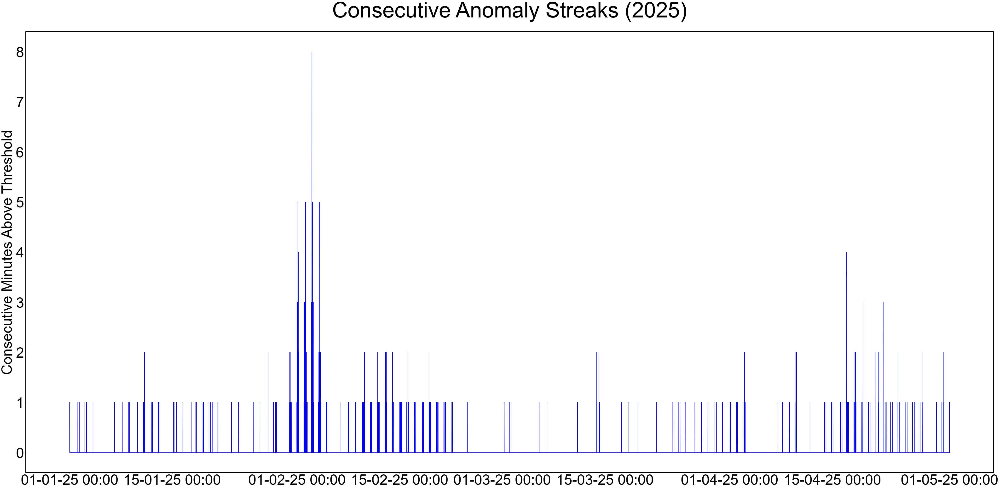

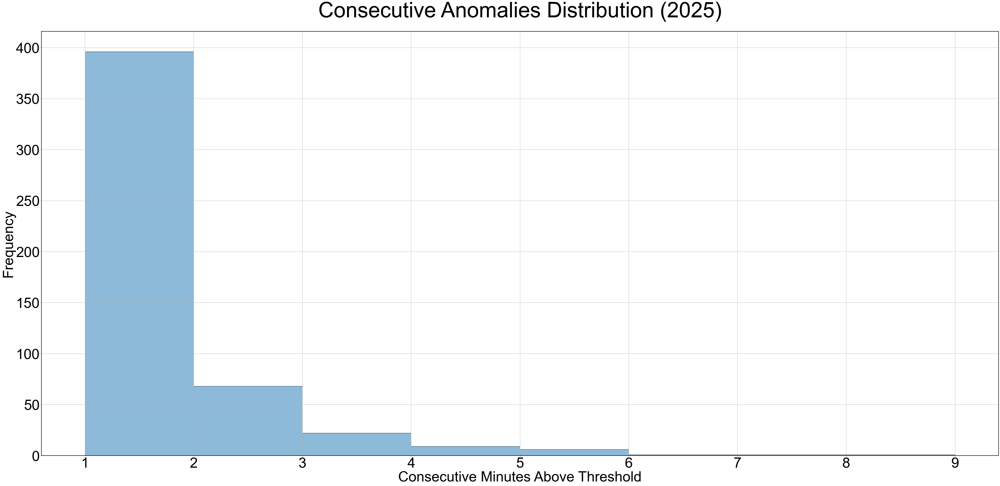

            max_dist
date                
2024-01-01         1
2024-01-02         0
2024-01-03         1
2024-01-04         0
2024-01-05         0
...              ...
2025-04-26         1
2025-04-27         2
2025-04-28         0
2025-04-29         1
2025-04-30         2

[486 rows x 1 columns]


In [36]:
value_col = Pout_cv_str

x = Pout_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)

def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Pout_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)

summary_df          = pd.DataFrame(results).set_index('date')
Pout_cv_flagged_all_SN = pd.concat(flagged_days)

data = Pout_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Outlet Pressure CV [%]')
plt.title(' Outlet Pressure CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout(); plt.show()

# Distribution of anomalies
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

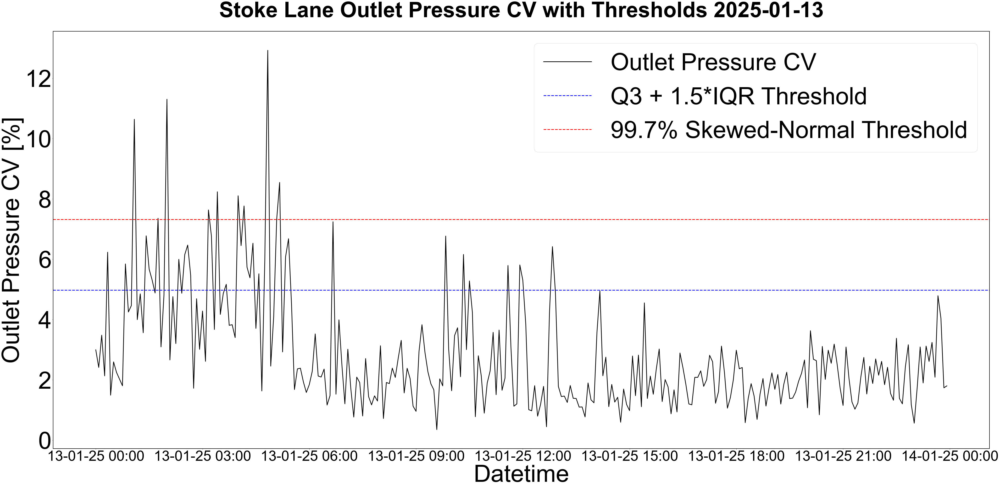

In [37]:
start, end = '2025-01-13', '2025-01-13'
data = Pout_cv_flagged_all_SN.loc[start:end]
IQRT = Pout_cv_flagged_all['cv_upper_iq'][0]
SNT = Pout_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Pout_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label='Outlet Pressure CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Skewed-Normal Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime', fontsize = 100)
ax.set_ylabel('Outlet Pressure CV [%]', fontsize = 100)
ax.set_title(f'Stoke Lane Outlet Pressure CV with Thresholds {start}', fontweight = 'bold')
ax.legend( fontsize = 100)
plt.xticks(fontsize=60)
plt.yticks(fontsize=100)
plt.tight_layout()
plt.show()

### 4.6. Inlet Pressure CV w/ 99.7% SN Thresholds

Best fit by AIC: skew-normal (AIC_sn=239140.9, AIC_g=2417363.7)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'skew-normal' → 99.7th percentile = 3.457


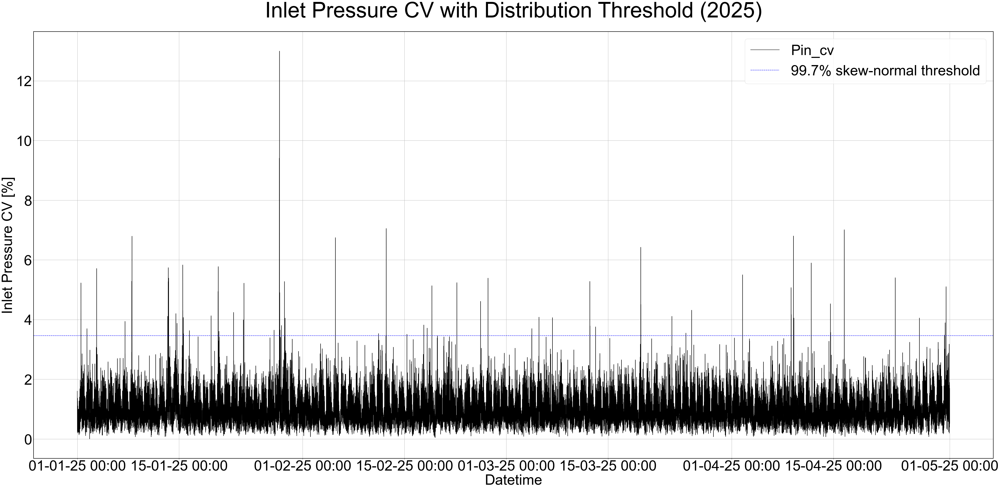

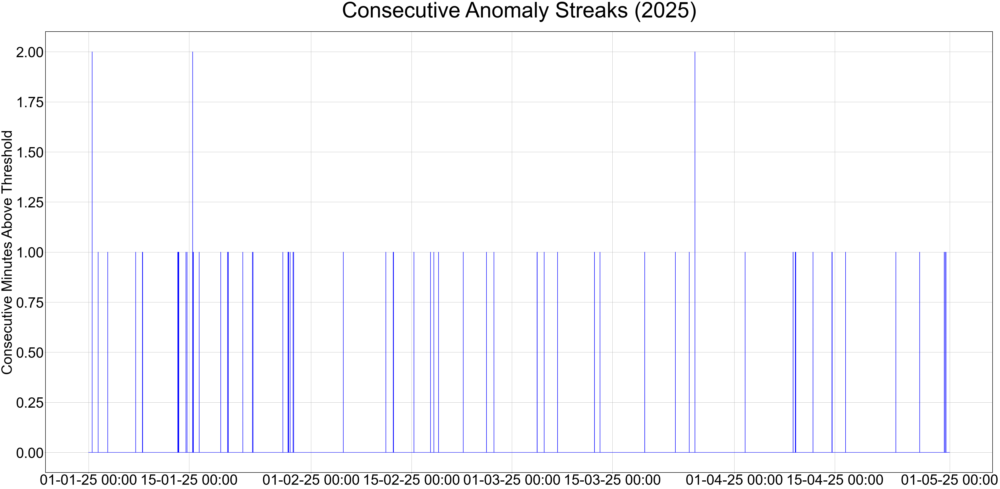

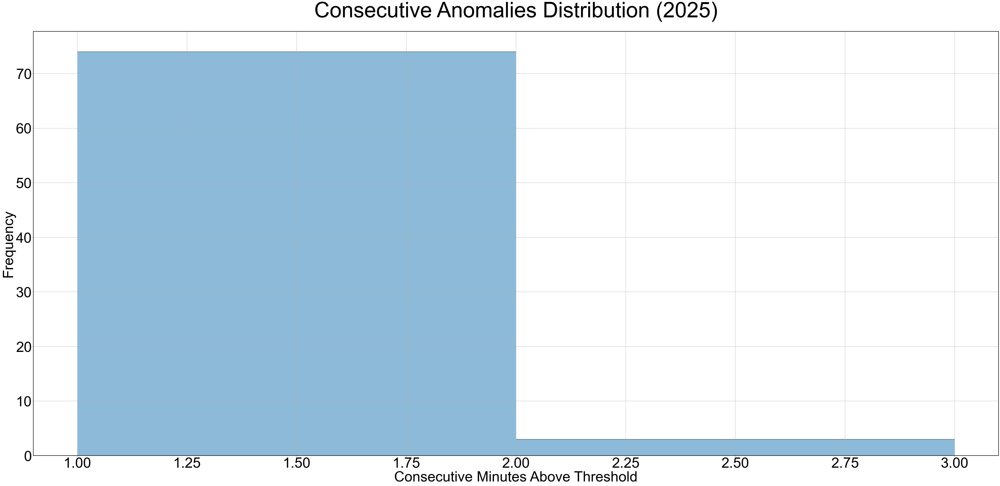

            max_dist
date                
2024-01-01         0
2024-01-02         0
2024-01-03         1
2024-01-04         0
2024-01-05         1
...              ...
2025-04-26         1
2025-04-27         0
2025-04-28         0
2025-04-29         0
2025-04-30         1

[486 rows x 1 columns]


In [38]:
value_col = Pin_cv_str

x = Pin_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)

def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Pin_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)

summary_df          = pd.DataFrame(results).set_index('date')
Pin_cv_flagged_all_SN = pd.concat(flagged_days)

data = Pin_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Inlet Pressure CV [%]')
plt.title('Inlet Pressure CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomalies
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

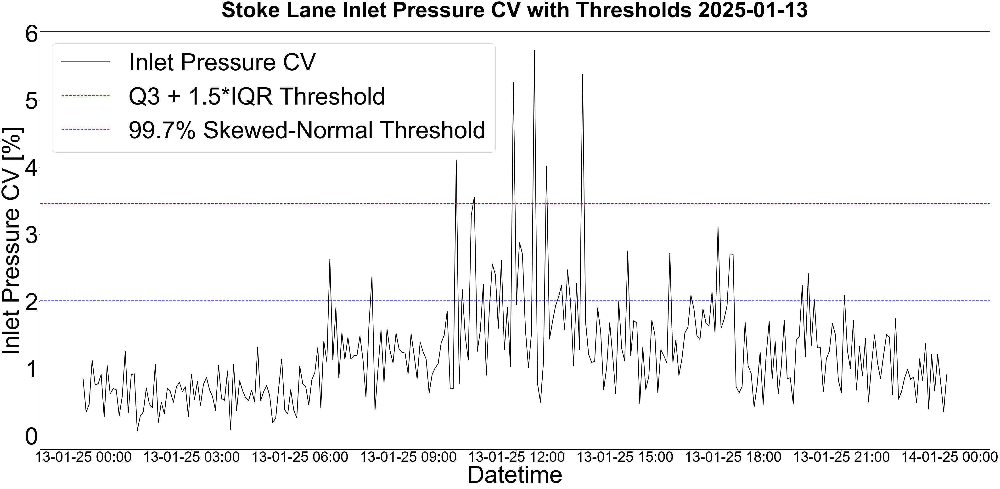

In [39]:
start, end = '2025-01-13', '2025-01-13'
data = Pin_cv_flagged_all_SN.loc[start:end]
IQRT = Pin_cv_flagged_all['cv_upper_iq'][0]
SNT = Pin_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Pin_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label='Inlet Pressure CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Skewed-Normal Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime', fontsize = 100)
ax.set_ylabel('Inlet Pressure CV [%]', fontsize = 100)
ax.set_title(f'Stoke Lane Inlet Pressure CV with Thresholds {start}', fontweight = 'bold')
ax.legend( fontsize = 100)
plt.xticks(fontsize=60)
plt.yticks(fontsize=100)
plt.tight_layout()
plt.show()

### 4.7. Results Analysis

In [40]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    mask = df['cv_count_iq'] > 0

    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')

    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()
    avg_minutes = total_minutes / n_days
    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths < 5).sum()
    n_lt15    = (event_lengths < 15).sum()
    n_lt60    = (event_lengths < 60).sum()
    n_gt60    = (event_lengths > 60).sum() 

    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()

    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()

    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  single-minute:           {n_single}")
    print(f"  <5 min:                  {n_lt5-n_single}")
    print(f"  <15 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [41]:
models = {
    'Flow CV IQR Thresholds': Flow_cv_flagged_all,
    'Pout CV IQR Thresholds': Pout_cv_flagged_all,
    'Pin CV IQR Thresholds': Pin_cv_flagged_all
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Flow CV IQR Thresholds ===
Total flagged minutes:    42240
Avg anomaly‐minutes/day:  86.91
Avg anomaly‐events/day:   11.65

Event duration counts:
  single-minute:           3913
  <5 min:                  1494
  <15 min:                 140
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2025-04 (1316 min)
  Least: 2024-09 (121 min)

Anomaly‐events by month:
  Most:  2025-04 (748 events)
  Least: 2024-09 (106 events)
Total events:             5431

=== Pout CV IQR Thresholds ===
Total flagged minutes:    24610
Avg anomaly‐minutes/day:  50.64
Avg anomaly‐events/day:   9.78

Event duration counts:
  single-minute:           2529
  <5 min:                  779
  <15 min:                 75
  <1 h:                    1
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2025-02 (849 min)
  Least: 2024-06 (0 min)

Anomaly‐events by month:
  Most:  2024-12 (492 events)
  Least: 2024-08 (2 events)
Total events:             3268


In [42]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    mask = df['cv_count_dist'] > 0

    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')

    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()
    avg_minutes = total_minutes / n_days

    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths < 5).sum()
    n_lt15    = (event_lengths < 15).sum()
    n_lt60    = (event_lengths < 60).sum()
    n_gt60    = (event_lengths > 60).sum() 

    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()

    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()

    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  single-minute:           {n_single}")
    print(f"  <5 min:                  {n_lt5-n_single}")
    print(f"  <15 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [43]:
models = {
    'Flow CV SN Thresholds': Flow_cv_flagged_all_SN,
    'Pout CV SN Thresholds': Pout_cv_flagged_all_SN,
    'Pin CV SN Thresholds': Pin_cv_flagged_all_SN
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Flow CV SN Thresholds ===
Total flagged minutes:    10715
Avg anomaly‐minutes/day:  22.05
Avg anomaly‐events/day:   5.61

Event duration counts:
  single-minute:           1603
  <5 min:                  240
  <15 min:                 3
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2024-12 (465 min)
  Least: 2024-06 (10 min)

Anomaly‐events by month:
  Most:  2024-12 (368 events)
  Least: 2024-06 (10 events)
Total events:             1826

=== Pout CV SN Thresholds ===
Total flagged minutes:    6010
Avg anomaly‐minutes/day:  12.37
Avg anomaly‐events/day:   4.76

Event duration counts:
  single-minute:           851
  <5 min:                  135
  <15 min:                 8
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2025-02 (284 min)
  Least: 2024-04 (0 min)

Anomaly‐events by month:
  Most:  2025-02 (199 events)
  Least: 2024-08 (2 events)
Total events:             985

=== Pin CV S

In [87]:
FF = Flow_cv_flagged_all_SN[Flow_cv_flagged_all_SN['cv_count_dist']>0]
PoF = Pout_cv_flagged_all_SN[Pout_cv_flagged_all_SN['cv_count_dist']>0]
PiF = Pin_cv_flagged_all_SN[Pin_cv_flagged_all_SN['cv_count_dist']>0]
target = residual_flagged_all[residual_flagged_all['count']>0]

for df in [
    FF,
    PoF,
    PiF,
   target,
]:
    df.index = pd.to_datetime(df.index)

label_ts = set(target.index)
def pct_in_label_floored(df):
    total = len(df)
    if total == 0:
        return 0.0
    floored_index = df.index
    matched = floored_index.isin(label_ts).sum()
    return matched / total * 100

results = {
    "Flow CV SN Thresholds": pct_in_label_floored(FF),
    "Pout CV SN Thresholds": pct_in_label_floored(PoF),
    "Pin CV SN Thresholds": pct_in_label_floored(PiF),
}

for name, pct in results.items():
    print(f"{name}: {pct:.2f}% of index‐timestamps (floored to 5T) appear in labelled_flagged_features")
    

Flow CV SN Thresholds: 3.03% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pout CV SN Thresholds: 2.83% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pin CV SN Thresholds: 13.41% of index‐timestamps (floored to 5T) appear in labelled_flagged_features


In [88]:
FF = Flow_cv_flagged_all[Flow_cv_flagged_all['cv_count_iq']>0]
PoF = Pout_cv_flagged_all[Pout_cv_flagged_all['cv_count_iq']>0]
PiF = Pin_cv_flagged_all[Pin_cv_flagged_all['cv_count_iq']>0]
target = normalised_flagged_all[normalised_flagged_all['count']>0]


for df in [
    FF,
    PoF,
    PiF,
    target,
]:
    df.index = pd.to_datetime(df.index)

label_ts = set(target.index)

def pct_in_label_floored(df):
    total = len(df)
    if total == 0:
        return 0.0
    floored_index = df.index
    matched = floored_index.isin(label_ts).sum()
    return matched / total * 100

results = {
    "Flow CV IQR Thresholds": pct_in_label_floored(FF),
    "Pout CV IQR Thresholds": pct_in_label_floored(PoF),
    "Pin CV IQR Thresholds": pct_in_label_floored(PiF),
}

for name, pct in results.items():
    print(f"{name}: {pct:.2f}% of index‐timestamps (floored to 5T) appear in labelled_flagged_features")
    
for df in [FF, PoF, PiF, target]:
    df.index = pd.to_datetime(df.index)

combined_ts = set(FF.index).union(PoF.index).union(PiF.index)

matched_in_target = target.index.isin(combined_ts).sum()
total_target = len(target)

if total_target > 0:
    pct_combined = matched_in_target / total_target * 100
else:
    pct_combined = 0.0

print(f"{pct_combined:.2f}% of target timestamps are from FF, PoF, or PiF combined")


Flow CV IQR Thresholds: 9.87% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pout CV IQR Thresholds: 6.68% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pin CV IQR Thresholds: 11.40% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
9.79% of target timestamps are from FF, PoF, or PiF combined


### 4.8. Feature Extraction

In [44]:
flagged_features['Flow_cv_count_iq']    = Flow_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]
flagged_features['Pout_cv_count_iq']    = Pout_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]
flagged_features['Pin_cv_count_iq']    = Pin_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]

flagged_features = flagged_features.fillna(0)
flagged_features

,Flow,Pin,Pout,Pres,normalised,Flow_roc,Pin_roc,Pout_roc,Flow_cv,Pin_cv,Pout_cv,Fixed_outlet_pressure,count,absdiff,Flow_cv_count_iq,Pout_cv_count_iq,Pin_cv_count_iq
2024-02-01 00:35:00,8.74260,51.925600,14.749600,0.77200,0.088627,0.041880,0.075520,0.006840,1.488941,0.578923,1.693921,0,1,0.077188,0,0,0
2024-02-01 06:20:00,9.06400,49.351800,12.430800,-1.60660,-0.176473,0.338040,-0.179920,-0.056360,9.337813,1.697133,2.571342,0,1,0.650822,1,0,0
2024-02-01 10:15:00,15.66260,46.926400,17.442400,1.43600,0.091919,-0.134720,0.088960,0.044320,2.742031,0.947413,1.161446,0,1,0.036339,0,0,0
2024-02-01 14:25:00,11.93760,48.235800,15.883600,1.23480,0.103813,-0.411960,0.185720,0.072360,1.168218,1.238921,3.010271,0,1,0.011253,0,0,0
2024-02-01 20:00:00,16.25180,48.133600,17.418000,1.06760,0.066665,-0.057440,0.047160,0.053240,4.515204,0.363285,0.783183,0,1,0.029403,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-04-30 20:50:00,20.21880,44.464600,26.448000,2.21260,0.110001,0.054670,-0.042553,-0.017997,2.416883,0.696018,0.578333,0,2,0.965890,0,0,0
2025-04-30 20:55:00,19.02200,44.336600,26.375200,3.15260,0.167820,-0.239360,-0.025600,-0.014560,5.136984,1.310100,0.360231,0,3,0.143173,0,0,0
2025-04-30 21:05:00,18.94260,43.861400,26.272600,3.11240,0.165686,-0.337640,0.229560,0.075920,4.291747,1.219218,0.304661,0,1,1.591882,0,0,0
2025-04-30 21:10:00,20.20580,44.203400,26.188400,1.92680,0.097026,0.252640,0.068400,-0.016840,4.398173,1.098162,0.906706,0,2,0.250083,0,0,0


### 4.9. Dynamic Time Warping

This section provides plots for dynamic time warping showing their ideal warping paths. Start and end dates can be adjusted to view different periods

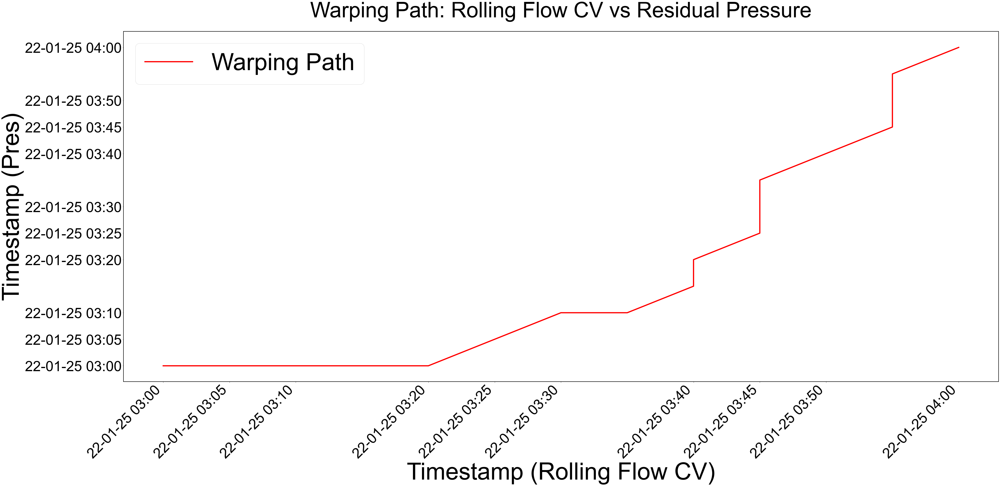

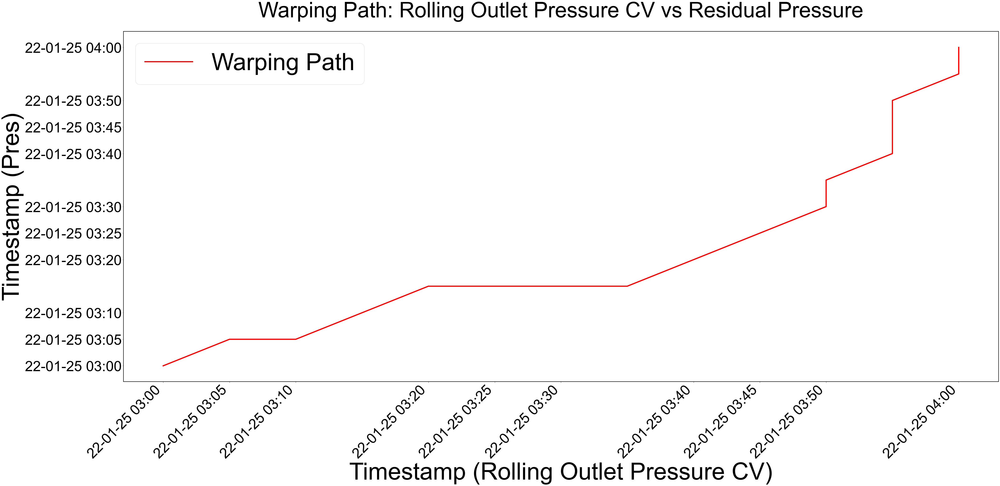

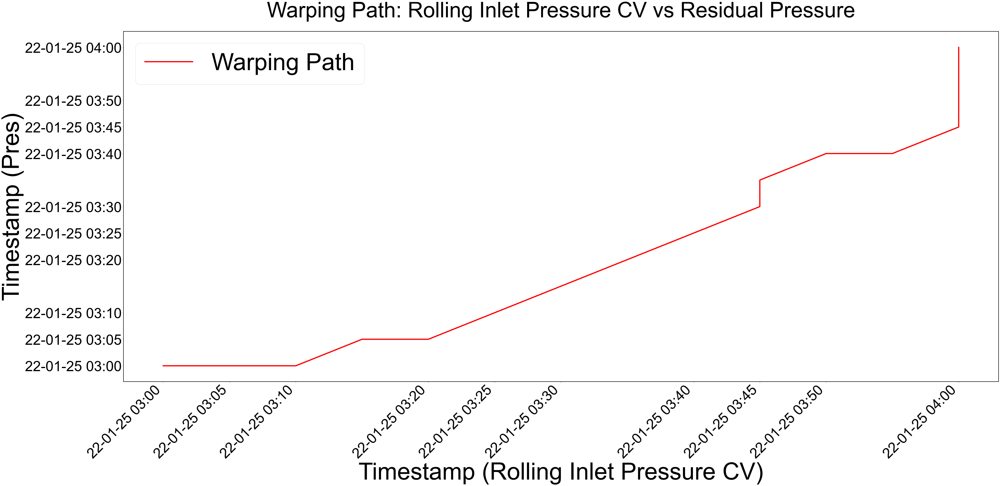


=== Rolling Flow CV vs Pres ===
DTW distance: 3.5993
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
  2025-01-22 03:45:00 ↔ 2025-01-22 03:25:00
Total synchronized events: 1

=== Rolling Outlet Pressure CV vs Pres ===
DTW distance: 2.2523
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
  2025-01-22 03:45:00 ↔ 2025-01-22 03:25:00
Total synchronized events: 1

=== Rolling Inlet Pressure CV vs Pres ===
DTW distance: 2.1280
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
  2025-01-22 03:40:00 ↔ 2025-01-22 03:25:00
Total synchronized events: 1


In [86]:
start = '2025-01-22 03:00'
end   = '2025-01-22 04:00'

def zscore_normalize(s: pd.Series) -> pd.Series:
    return (s - s.mean()) / s.std()

flow_norm = zscore_normalize(Flow_cv_rolling[start:end].iloc[:, 0])
pout_norm = zscore_normalize(Pout_cv_rolling[start:end].iloc[:, 0])
pin_norm  = zscore_normalize(Pin_cv_rolling[start:end].iloc[:, 0])
pres_norm = zscore_normalize(Pres[start:end].iloc[:, 0])

# For each CV series, compute DTW distance, alignment path, detect peaks, map synchronized events, plot normalized series, and plot warping path only (no colormap)
results = {}

for label, series_norm in [
    ("Rolling Flow CV", flow_norm),
    ("Rolling Outlet Pressure CV", pout_norm),
    ("Rolling Inlet Pressure CV", pin_norm),
]:

    distance = dtw.distance(series_norm.values, pres_norm.values)
    alignment_path = dtw.warping_path(series_norm.values, pres_norm.values)

    peaks1, _ = find_peaks(series_norm, prominence=1)
    peaks2, _ = find_peaks(pres_norm,   prominence=1)
    synchronized_events = []
    for p1 in peaks1:
        for (i, j) in alignment_path:
            if i == p1 and j in peaks2:
                synchronized_events.append((series_norm.index[p1], pres_norm.index[j]))

    x = series_norm.values
    y = pres_norm.values

    n, m = len(x), len(y)
    path_i = np.array([p[0] for p in alignment_path])
    path_j = np.array([p[1] for p in alignment_path])

    fig_path, ax_path = plt.subplots()
    ax_path.plot(path_i, path_j, color='red', linewidth=5, label='Warping Path')
    num_ticks = 10
    x_tick_positions = np.linspace(0, n - 1, num_ticks, dtype=int)
    y_tick_positions = np.linspace(0, m - 1, num_ticks, dtype=int)

    x_tick_labels = [
        series_norm.index[pos].strftime('%d-%m-%y %H:%M')
        for pos in x_tick_positions
    ]
    y_tick_labels = [
        pres_norm.index[pos].strftime('%d-%m-%y %H:%M')
        for pos in y_tick_positions
    ]

    ax_path.set_xticks(x_tick_positions)
    ax_path.set_xticklabels(x_tick_labels, rotation=45, ha='right')
    ax_path.set_yticks(y_tick_positions)
    ax_path.set_yticklabels(y_tick_labels)

    ax_path.set_title(f"Warping Path: {label} vs Residual Pressure")
    ax_path.set_xlabel(f"Timestamp ({label})", fontsize=100)
    ax_path.set_ylabel("Timestamp (Pres)", fontsize=100)
    ax_path.legend(fontsize=100)
    plt.tight_layout()
    plt.show()

    results[label] = {
        'dtw_distance': distance,
        'alignment_path': alignment_path,
        'peaks_in_' + label: peaks1,
        'peaks_in_Pres': peaks2,
        'synchronized_events': synchronized_events
    }

for label, info in results.items():
    print(f"\n=== {label} vs Pres ===")
    print(f"DTW distance: {info['dtw_distance']:.4f}")
    print("Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):")
    for (t1, t2) in info['synchronized_events']:
        print(f"  {t1} ↔ {t2}")
    print(f"Total synchronized events: {len(info['synchronized_events'])}")

In [46]:
#flagged_features.to_csv("C:/Users/megat/Desktop/MegatAiman/University/Year4/FYP/Data/StokeLane/FlaggedData/Flagged_features_SL.csv", index=True)

## 5. Drift Detection

This section provides the analysis using the CUSUM and BOCPD models. Start and end dates can be adjusted to view different periods.

### 5.1. CUSUM

In [47]:
def cusum_daily_mean(df, col='residual_pressure', baseline_days=7, k=None, h=None):
    """
    Parameters
    ----------
    df              : DataFrame
                      Minute‐level data with a DateTimeIndex and a column named `col`.
    col             : str, default 'residual_pressure'
                      Which column to aggregate.
    baseline_days   : int, default 7
                      How many initial days to use for the reference mean.
    k               : float or None, default None
                      Slack parameter for CUSUM; if None, uses std(daily means).
    h               : float or None, default None
                      Threshold for alert; if None, uses 3×std(daily means).
    """

    daily = df[col].resample('D').mean()
    mu0 = daily.iloc[:baseline_days].mean()
    sigma = daily.iloc[:baseline_days].std()
    if k is None:
        k = sigma
    if h is None:
        h = 1 * sigma

    c_p, c_n = 0.0, 0.0
    pos, neg, flags = [], [], []
    for x in daily:
        delta = x - mu0
        c_p = max(0, c_p + delta - k)
        c_n = min(0, c_n + delta + k)
        pos.append(c_p)
        neg.append(c_n)
        flags.append(int(c_p > h or abs(c_n) > h))

    return pd.DataFrame({
        'daily_mean': daily,
        'cusum_pos':  pos,
        'cusum_neg':  neg,
        'drift_flag': flags
    }, index=daily.index)

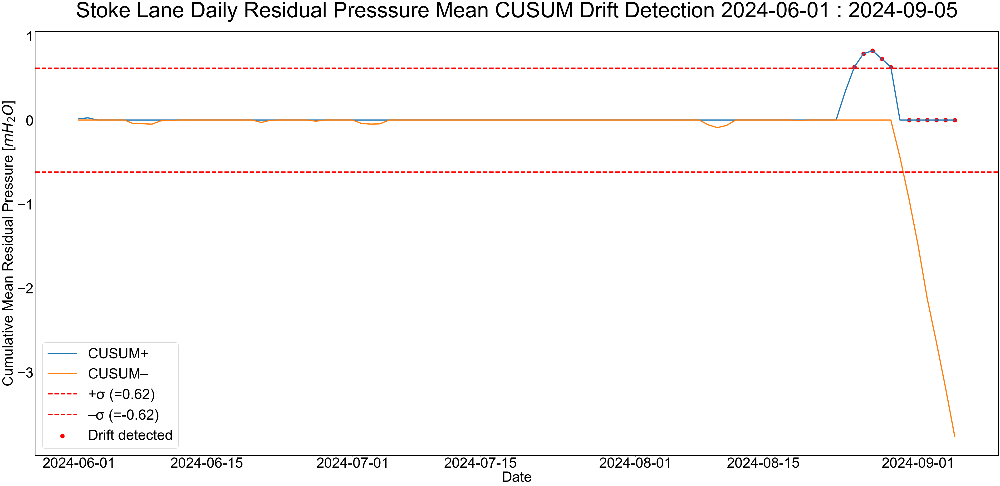

In [48]:
start = '2024-06-01'
end = '2024-09-05'

sigma = float(Pres['2024-01'].std())
h = 1 * sigma

cusum_df = cusum_daily_mean(Pres[start:end], col='residual_pressure', h = h)

plt.figure()
plt.plot(cusum_df.index, cusum_df['cusum_pos'], label='CUSUM+', linewidth=5)
plt.plot(cusum_df.index, cusum_df['cusum_neg'], label='CUSUM–', linewidth=5)
plt.axhline(h, color='red', linestyle='--', label=f'+σ (={h:.2f})', linewidth=5)
plt.axhline(-h, color='red', linestyle='--', label=f'–σ (={-h:.2f})', linewidth=5)
drift_days = cusum_df[cusum_df['drift_flag'] == 1]
plt.scatter(drift_days.index, drift_days['cusum_pos'],
            color='red', marker='o', s=300, label='Drift detected')

plt.xlabel('Date')
plt.ylabel(r'Cumulative Mean Residual Pressure [$mH_2O$]')
plt.title(f'Stoke Lane Daily Residual Presssure Mean CUSUM Drift Detection {start} : {end}')
plt.legend()
plt.tight_layout()
plt.show()

### 5.3. Bayesian Online Changepoint Detection

In [49]:
class OnlineBOCPD:
    def __init__(
        self,
        hazard=1/200,
        alpha=1.0,
        beta=1.0,
        kappa=1.0,
        mu0=0.0,
        T=1000,
        cp_threshold=0.1,
        max_run_length=None,
    ):
        """
        Parameters:
        - hazard: constant hazard rate
        - alpha, beta, kappa, mu0: Normal-Inverse-Gamma prior params
        - T: maximum time steps for run-length grid
        - cp_threshold: threshold on cp_prob to define raw is_cp
        - max_run_length: optional periodic reset interval
        """
        self.hazard = hazard
        self.T = T
        self.cp_threshold = cp_threshold
        self.max_run_length = max_run_length

        # Prior hyperparameters
        self.alpha0 = alpha
        self.beta0 = beta
        self.kappa0 = kappa
        self.mu0 = mu0

        # Initialize run-length posterior matrix R
        self.R = np.zeros((T + 1, T + 1))
        self.R[0, 0] = 1.0

        # Posterior hyperparams per run length
        self.muT    = {0: mu0}
        self.kappaT = {0: kappa}
        self.alphaT = {0: alpha}
        self.betaT  = {0: beta}

        self.cp_times = []
        self.cp_probs  = []
        self.raw_flags = []
        self.cp_flags  = []

    def update(self, x, t):
        if self.max_run_length and t > 0 and t % self.max_run_length == 0:
            self.R[:] = 0.0
            self.R[0, t] = 1.0
            self.muT    = {0: self.mu0}
            self.kappaT = {0: self.kappa0}
            self.alphaT = {0: self.alpha0}
            self.betaT  = {0: self.beta0}

        # Predictive probabilities under Student-t
        pred = np.zeros(t + 1)
        for rl in range(t + 1):
            mu, kappa = self.muT[rl], self.kappaT[rl]
            alpha, beta = self.alphaT[rl], self.betaT[rl]
            scale = np.sqrt((beta * (kappa + 1)) / (alpha * kappa))
            pred[rl] = student_t.pdf(x, df=2 * alpha, loc=mu, scale=scale)

        prev = self.R[:t + 1, t]
        growth = prev * pred * (1 - self.hazard)
        cp_prob = np.sum(prev * pred * self.hazard)

        # Update run-length posterior matrix for t+1
        self.R[1:t + 2, t + 1] = growth
        self.R[0,    t + 1] = cp_prob
        self.R[:,    t + 1] /= np.sum(self.R[:, t + 1])

        # Update hyperparameters
        new_muT, new_kappaT = {0: self.mu0}, {0: self.kappa0}
        new_alphaT, new_betaT = {0: self.alpha0}, {0: self.beta0}
        for rl in range(t + 1):
            mu, kappa = self.muT[rl], self.kappaT[rl]
            alpha, beta = self.alphaT[rl], self.betaT[rl]
            nk = kappa + 1
            nm = (kappa * mu + x) / nk
            na = alpha + 0.5
            nb = beta + (kappa * (x - mu)**2) / (2 * nk)
            new_muT[rl + 1]    = nm
            new_kappaT[rl + 1] = nk
            new_alphaT[rl + 1] = na
            new_betaT[rl + 1]  = nb
        self.muT, self.kappaT = new_muT, new_kappaT
        self.alphaT, self.betaT = new_alphaT, new_betaT

        # Record and return cp_prob
        self.cp_probs.append(cp_prob)
        return cp_prob

    def run(self, data, time_index=None):
        n = len(data)
        self.raw_flags = []
        self.cp_flags  = []
        self.cp_times  = []
        self.cp_probs  = []

        for i, x in enumerate(data):
            cp = self.update(x, i)
            self.raw_flags.append(int(cp < self.cp_threshold))
        idx = time_index if time_index is not None else pd.Index(np.arange(n))
        day0_end = idx[0] + pd.Timedelta(days=45)
        final = [0]*n
        for i in range(n - 2):
            if (self.raw_flags[i] and self.raw_flags[i+1]):
                if idx[i] > day0_end:
                    final[i] = 1
        self.cp_flags = final
        self.cp_times = [idx[i] for i, f in enumerate(final) if f]

        df = pd.DataFrame({
            'value':    data,
            'cp_prob':  self.cp_probs,
            'cp_flag':  self.cp_flags
        }, index=idx)
        return df

    def plot(self, time_index, data, threshold=None):
        df = self.run(data, time_index)
        plt.figure()
        plt.plot(df.index, df['value'], label='Normalised Residual Pressure', linewidth = 3)
        for t in self.cp_times:
            plt.axvline(t, color='red', linestyle='--', linewidth = 3)
        plt.title('Stoke Lane Normalised Residual Bayesian Online Changepoint Detection')
        plt.xlabel('Time'); plt.ylabel(r'Normalised Residual Pressure [$mH_2O$ / L/s]')
        plt.legend();  plt.grid(True); plt.tight_layout(); plt.show()
        
        plt.figure()
        plt.plot(df.index, df['cp_prob'], label=r'P($r_t$=0)', color='orange', linewidth = 3)
        for t in self.cp_times:
            plt.axvline(t, color='red', linestyle='--', linewidth = 2)
        plt.title('Changepoint Probability Over Time')
        plt.xlabel('Time'); plt.ylabel('P(run length = 0)')
        plt.legend(); plt.grid(True); plt.tight_layout(); plt.show()
        return df


               value   cp_prob  cp_flag
2024-01-01  0.023344  0.022822        0
2024-01-02  0.019551  0.037368        0
2024-01-03  0.026979  0.046769        0
2024-01-04  0.022899  0.054284        0
2024-01-05  0.025415  0.060806        0
2024-01-06  0.014570  0.066704        0
2024-01-07  0.023011  0.072195        0
2024-01-08  0.026979  0.077347        0
2024-01-09  0.022790  0.082244        0
2024-01-10  0.023509  0.086910        0

Changepoints detected at:
               value   cp_prob  cp_flag
2024-05-15 -0.173731  0.075828        1


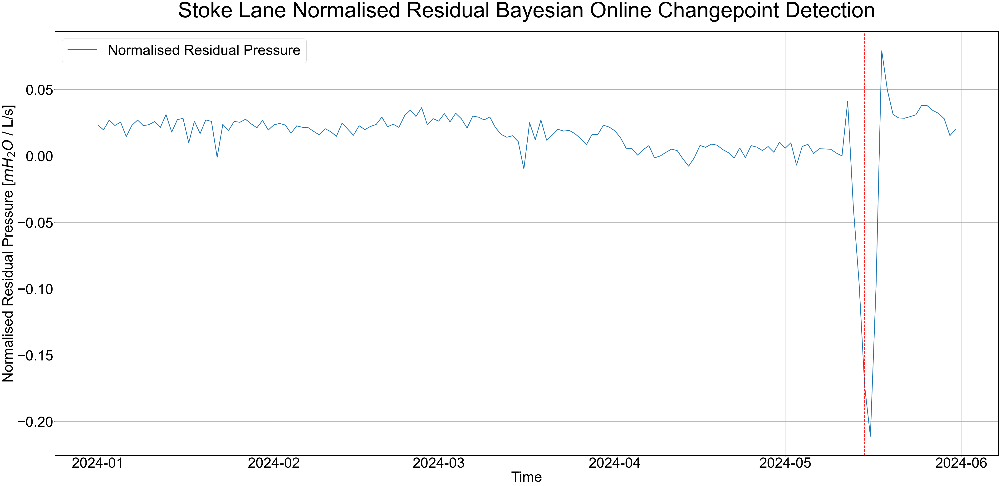

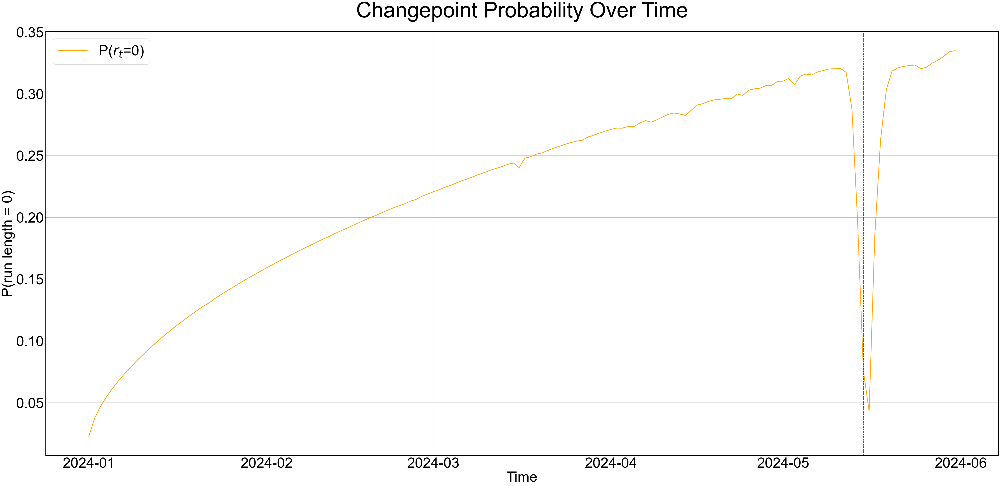

,value,cp_prob,cp_flag
2024-01-01,0.023344,0.022822,0
2024-01-02,0.019551,0.037368,0
2024-01-03,0.026979,0.046769,0
2024-01-04,0.022899,0.054284,0
2024-01-05,0.025415,0.060806,0
...,...,...,...
2024-05-27,0.034199,0.324685,0
2024-05-28,0.032021,0.327005,0
2024-05-29,0.027934,0.330031,0
2024-05-30,0.015273,0.334086,0


In [50]:
hourly_data = (
    Normalised[Normalised_str]['2024-01':'2024-05']
      .resample('24H')
      .mean()
      .dropna()
)

values     = hourly_data.values
time_index = hourly_data.index
mu0_est    = Normalised[Normalised_str]['2024-01'].mean()

bocd = OnlineBOCPD(
    hazard=0.1,
    alpha=1.0, beta=0.8, kappa=0.5,
    mu0=mu0_est,
    T=len(values),
    cp_threshold=0.1,
    max_run_length=None
)

results = bocd.run(values, time_index=time_index)

print(results.head(10))
print("\nChangepoints detected at:")
print(results[results['cp_flag'] == 1])

bocd.plot(time_index, values)

## 6. Event labelling

This section provides plotting code of the original timeseries valve measurements to identify and label faults. The first code block allows for manual adjustment of the start and end dates whilst the second code block provides an automated plotting code of all faults between specified dates.

In [52]:
# for ts in residual_flagged_all['2025-03-13'].index[residual_flagged_all['count']['2025-03-13'] == 5 ]:
#     start = ts - pd.Timedelta(minutes=90)
#     end = ts + pd.Timedelta(minutes=90)

#     fig, ax1 = plt.subplots()

#     ax1.plot(Pin[start:end], label='P_in', color='red')
#     ax1.plot(Pout[start:end], label='P_out', color='blue')
#     ax1.plot(Ptarget[start:end], label='P_target', color='cyan')
#     ax1.plot(Stem1[start:end], label='Stem_Pos', color ='black')
#     ax1.set_ylabel(r'Pressure [$mH_2O$] / Stem position [mm]')
#     ax1.set_xlabel('Date-time')
#     ax1.axvline(ts, color='black', linestyle='--', linewidth=2, label='Threshold Exceeded')

#     ax2 = ax1.twinx()
#     ax2.plot(Flow[start:end], label='Flow', color='green')
#     ax2.set_ylabel('Flow [L/s]')

 
#     ax1.set_title(f'Stoke Lane {T_str} Readings around {ts.strftime("%d-%m-%y %H:%M")}', fontweight='bold')
#     lines_1, labels_1 = ax1.get_legend_handles_labels()
#     lines_2, labels_2 = ax2.get_legend_handles_labels()
#     ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')
#     ax1.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))

#     plt.tight_layout()
#     plt.show()

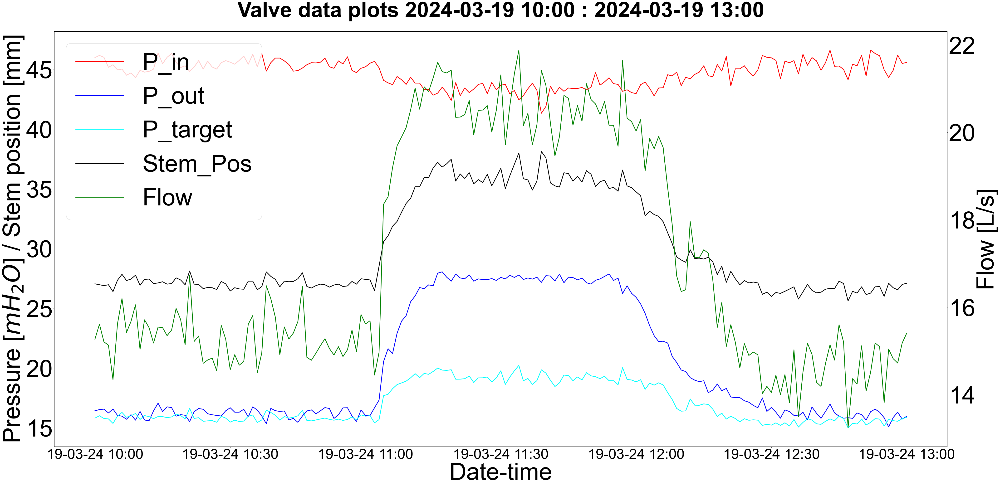

In [53]:
start = '2024-03-19 10:00'
end = '2024-03-19 13:00'

fig, ax1 = plt.subplots()

ax1.plot(Pin_1T[start:end], label='P_in', color='red', linewidth = 3)
ax1.plot(Pout_1T[start:end], label='P_out', color='blue', linewidth = 3)
ax1.plot(Ptarget_1T[start:end], label='P_target', color='cyan', linewidth = 3)
ax1.plot(Stem_1T[start:end], label='Stem_Pos', color ='black', linewidth = 3)
ax1.set_ylabel(r'Pressure [$mH_2O$] / Stem position [mm]', fontsize = 100)
ax1.set_xlabel('Date-time', fontsize = 100)
ax1.tick_params(axis='y', labelsize=100)
ax1.tick_params(axis='x', labelsize=60)

ax2 = ax1.twinx()
ax2.plot(Flow_1T[start:end], label='Flow', color='green', linewidth = 3)
ax2.set_ylabel('Flow [L/s]', fontsize = 100)


ax1.set_title(f'Valve data plots {start} : {end}', fontweight='bold')
lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', fontsize = 100)
ax1.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))

plt.xticks(fontsize = 100)
plt.yticks(fontsize = 100)
plt.tight_layout()
plt.show()

## 7. Random Forest

The code below represents the fault diagnosis pipeline with a random forest classifier. A preliminary analysis of the dataset is first carried out followed by model training, evaluation, and cross application.

### 7.1. Labelled dataset analysis

In [70]:
labelled_flagged_features = pd.read_csv("../../Data/StokeLane/FlaggedData/Flagged_features_SL_labelled.csv", parse_dates=[0], index_col=0)
labelled_flagged_features['label'].fillna('Unclassified', inplace=True)

In [73]:
n_unique = labelled_flagged_features['label'].nunique()
print(f"Number of unique labels: {n_unique}")

unique_labels = labelled_flagged_features['label'].unique()
print("Unique labels:", unique_labels)

label_counts = labelled_flagged_features['label'].value_counts()
print("Counts per label:")
print(label_counts)

Number of unique labels: 9
Unique labels: ['Drift' 'Failure' 'System_dynamics'
 'High_flow_dynamics_fixed_outlet_pressure' 'Likely_failure'
 'Speed_control' 'Large_step_change' 'Valve_dynamics'
 'Further_classification']
Counts per label:
Drift                                       10459
Failure                                      6635
High_flow_dynamics_fixed_outlet_pressure     2046
Large_step_change                             442
Further_classification                        425
System_dynamics                               163
Likely_failure                                123
Valve_dynamics                                 30
Speed_control                                  21
Name: label, dtype: int64


### 7.2. Model training & evaluation

In [74]:
def train_and_evaluate_rf2(
    df,
    feature_cols=None,
    label_col='label',
    test_size=0.3,
    random_state=42,
    grid_params=None,
    cv=5,
    n_jobs=-1
):

    start_time = time.time()
    df = df.copy()
    if not isinstance(df.index, pd.DatetimeIndex):
        df.index = pd.to_datetime(df.index.astype(str))
    df[label_col] = df[label_col].astype(str)
    if feature_cols is None:
        feature_cols = [c for c in df.columns if c != label_col]
    obj_cols = df[feature_cols].select_dtypes(include=['object', 'category']).columns.tolist()
    if obj_cols:
        df = pd.get_dummies(df, columns=obj_cols, drop_first=True)
        feature_cols = [c for c in df.columns if c != label_col]

    # Split into train/test
    X_full = df[feature_cols]
    y_full = df[label_col]

    X_train, X_test, y_train, y_test = train_test_split(
        X_full, y_full,
        test_size=test_size,
        stratify=y_full,
        random_state=random_state
    )

    # Train with or without GridSearchCV
    base_clf = RandomForestClassifier(random_state=random_state, class_weight='balanced')
    best_params = {}
    if grid_params:
        grid = GridSearchCV(
            estimator=base_clf,
            param_grid=grid_params,
            cv=cv,
            scoring='accuracy',
            n_jobs=n_jobs,
            refit=True
        )
        grid.fit(X_train, y_train)
        clf = grid.best_estimator_
        best_params = grid.best_params_
        print("Best parameters found by grid search:", best_params)
    else:
        clf = base_clf.fit(X_train, y_train)

    # Evaluate on test set
    y_pred_test = clf.predict(X_test)
    report_test = classification_report(y_test, y_pred_test)
    cm_test = confusion_matrix(y_test, y_pred_test)

    print("=== Test‐Set Classification Report (Random Forest) ===")
    print(report_test)

    # Compute metrics on the entire dataset
    y_pred_full = clf.predict(X_full)

    accuracy_overall = accuracy_score(y_full, y_pred_full)
    accuracy_macro = balanced_accuracy_score(y_full, y_pred_full)
    
    precision_macro = precision_score(y_full, y_pred_full, average='macro', zero_division=0)
    recall_macro    = recall_score(y_full, y_pred_full, average='macro', zero_division=0)
    f1_macro        = f1_score(y_full, y_pred_full, average='macro', zero_division=0)
    cm_full = confusion_matrix(y_full, y_pred_full, labels=clf.classes_)
    cm_full_df = pd.DataFrame(cm_full, index=clf.classes_, columns=clf.classes_)
    fpr_dict = {}
    for cls in clf.classes_:
        TN = cm_full_df.drop(index=cls, columns=cls).values.sum()
        FP = cm_full_df[cls].sum() - cm_full_df.at[cls, cls]
        fpr_dict[cls] = FP / (FP + TN) if (FP + TN) > 0 else 0.0

    fpr_per_class = pd.Series(fpr_dict).sort_index()
    total_FP = sum(fpr_dict[cls] * (fpr_dict[cls] + 
                 (cm_full_df.drop(index=cls, columns=cls).values.sum())) 
                   for cls in clf.classes_)
    total_FP = sum(cm_full_df[col].sum() - cm_full_df.at[col, col] for col in clf.classes_)
    total_TN = sum(cm_full_df.drop(index=cls, columns=cls).values.sum() for cls in clf.classes_)
    fpr_overall = total_FP / (total_FP + total_TN) if (total_FP + total_TN) > 0 else 0.0

    metrics_full = {
        'accuracy_overall': accuracy_overall,
        'accuracy_macro':   accuracy_macro,
        'precision_macro': precision_macro,
        'recall_macro':    recall_macro,
        'f1_macro':        f1_macro,
        'fpr_per_class':   fpr_per_class,
        'fpr_overall':     fpr_overall
    }

    print("\n=== Metrics on Full Dataset (macro-averaged) ===")
    print(f"Overall Accuracy       : {accuracy_overall:.3f}")
    print(f"Macro-Averaged Accuracy: {accuracy_macro:.3f}")
    print(f"Precision (macro) : {precision_macro:.3f}")
    print(f"Recall    (macro) : {recall_macro:.3f}")
    print(f"F1        (macro) : {f1_macro:.3f}")
    print("\nFalse Positive Rate per class:")
    print(fpr_per_class.to_frame(name='FPR'))
    print(f"\nOverall FPR (micro-averaged): {fpr_overall:.3f}")

    importances = pd.Series(
        clf.feature_importances_,
        index=feature_cols
    ).sort_values(ascending=False)

    class_labels = clf.classes_
    fig, ax = plt.subplots()
    sns.heatmap(
        cm_test,
        annot=True,
        fmt='d',
        cmap='Blues',
        xticklabels=class_labels,
        yticklabels=class_labels,
        ax=ax
    )
    ax.set_title('Confusion Matrix (Test Set)')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('True')
    plt.setp(ax.get_xticklabels(), rotation=25, ha='right')
    plt.setp(ax.get_yticklabels(), rotation=25, ha='right')
    plt.tight_layout()
    plt.show()

    top5 = importances.head(5)
    fig2, ax2 = plt.subplots()
    top5.plot(kind='bar', ax=ax2)
    ax2.set_title('Top 5 Feature Importances')
    ax2.set_ylabel('Importance')
    ax2.set_xlabel('Feature')
    plt.xticks(rotation=0, ha='center')
    plt.tight_layout()
    plt.show()

    elapsed_time_min = (time.time() - start_time) / 60
    print(f"\nFunction runtime: {elapsed_time_min:.2f} minutes")

    return (
        clf,
        report_test,
        cm_test,
        importances,
        metrics_full,
        best_params,
        elapsed_time_min
    )

Best parameters found by grid search: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}
=== Test‐Set Classification Report (Random Forest) ===
                                          precision    recall  f1-score   support

                                   Drift       1.00      1.00      1.00      3138
                                 Failure       0.99      1.00      1.00      1991
                  Further_classification       1.00      0.96      0.98       127
High_flow_dynamics_fixed_outlet_pressure       0.98      0.99      0.98       614
                       Large_step_change       0.94      0.98      0.96       133
                          Likely_failure       0.73      0.65      0.69        37
                           Speed_control       1.00      0.67      0.80         6
                         System_dynamics       0.91      0.63      0.75        49
                          Valve_dynamics       1.00      1

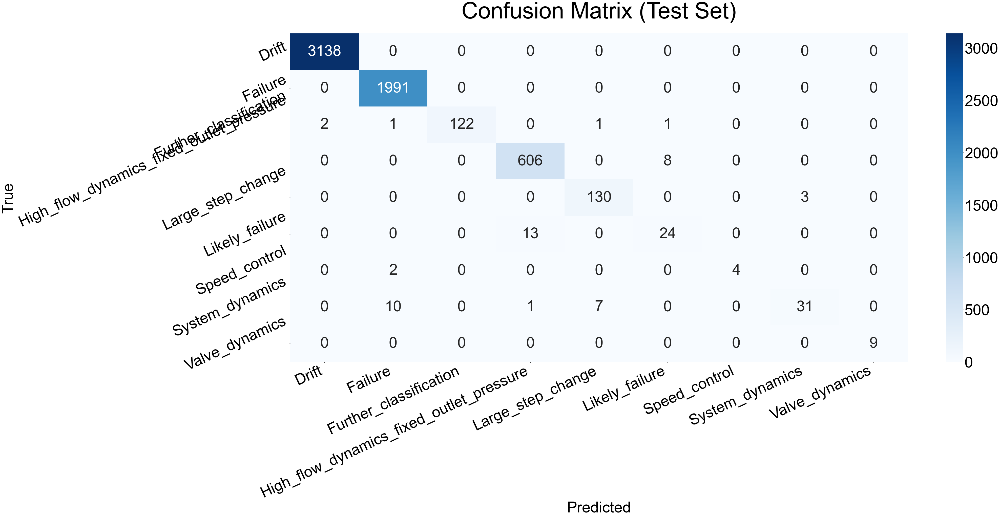

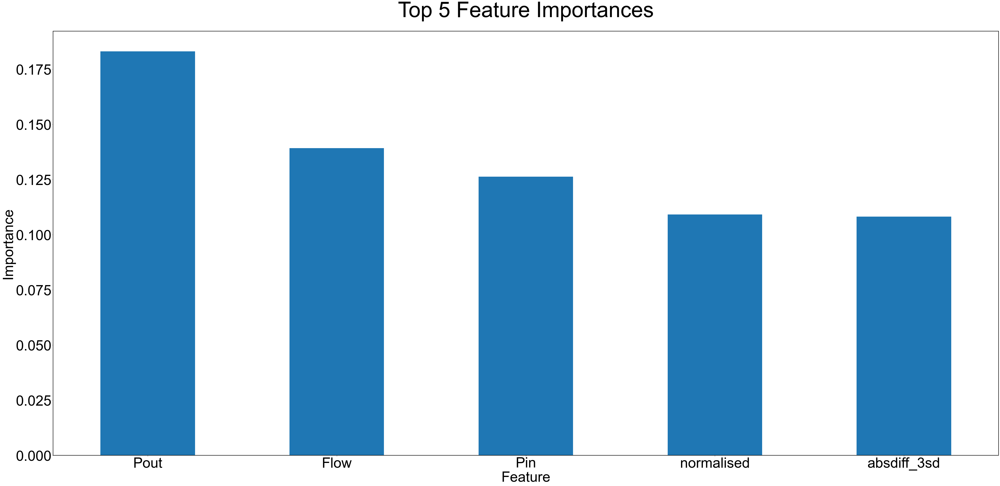


Function runtime: 15.89 minutes
Pout           0.183073
Flow           0.139233
Pin            0.126276
normalised     0.109177
absdiff_3sd    0.108169
Pres           0.099717
Pout_cv        0.081232
count_3sd      0.068411
Flow_cv        0.028061
Pin_cv         0.016991
dtype: float64
Precision (macro): 0.9863592346865041
Recall    (macro): 0.9629088105970314
F1        (macro): 0.974092601217955

False Positive Rate per class:
Drift                                       0.000202
Failure                                     0.000948
Further_classification                      0.000000
High_flow_dynamics_fixed_outlet_pressure    0.000765
Large_step_change                           0.000402
Likely_failure                              0.000445
Speed_control                               0.000000
System_dynamics                             0.000149
Valve_dynamics                              0.000000
dtype: float64
Tuned hyperparameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_sampl

In [75]:
from sklearn.model_selection import StratifiedKFold

grid_params = {
    'n_estimators':      [50, 100, 200],
    'max_depth':         [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf':  [1, 2, 4],
    'max_features':      ['sqrt', 'log2']
}

cv = 5  

clf, report_test, cm_test, importances, metrics_full, best_params, elapsed = train_and_evaluate_rf2(
    labelled_flagged_features,
    label_col='label',
    grid_params=grid_params,  # or None
    cv=5,
    test_size=0.3,
    random_state=42,
    n_jobs=-1
)


print(importances.head(10))
print("Precision (macro):", metrics_full['precision_macro'])
print("Recall    (macro):", metrics_full['recall_macro'])
print("F1        (macro):", metrics_full['f1_macro'])
print("\nFalse Positive Rate per class:")
print(metrics_full['fpr_per_class'])
print("Tuned hyperparameters:" , best_params)
print(f"Elapsed time: {elapsed:.2f} minutes")

In [76]:
data = {
    'C1': [123, 0,   1,   0,  0,  0,  0],
    'C2': [0,   601, 0,  13,  0,  0,  0],
    'C3': [0,   0, 130,  0,  0,  3,  0],
    'C4': [0,   10,  0,  27,  0,  0,  0],
    'C5': [0,   0,   0,   0,  5,  1,  0],
    'C6': [0,   1,   7,   0,  0, 35,  0],
    'C7': [0,   0,   0,   0,  0,  0,  9],
}
labels = ['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7']
cm_df = pd.DataFrame(data, index=labels)

tp = {}
fp = {}
fn = {}
tn = {}

total_samples = cm_df.values.sum()

for cls in labels:
    TP = cm_df.at[cls, cls]
    FP = cm_df[cls].sum() - TP
    FN = cm_df.loc[cls].sum() - TP
    TN = total_samples - (TP + FP + FN)
    tp[cls], fp[cls], fn[cls], tn[cls] = TP, FP, FN, TN

tp_s = pd.Series(tp)
fp_s = pd.Series(fp)
fn_s = pd.Series(fn)
tn_s = pd.Series(tn)

precision_per_class = {}
recall_per_class = {}
f1_per_class = {}

for cls in labels:
    TP = tp_s[cls]
    FP = fp_s[cls]
    FN = fn_s[cls]
    prec = TP / (TP + FP) if (TP + FP) > 0 else 0.0
    rec  = TP / (TP + FN) if (TP + FN) > 0 else 0.0
    f1   = 2 * (prec * rec) / (prec + rec) if (prec + rec) > 0 else 0.0
    
    precision_per_class[cls] = prec
    recall_per_class[cls] = rec
    f1_per_class[cls] = f1

prec_series = pd.Series(precision_per_class)
rec_series = pd.Series(recall_per_class)
f1_series = pd.Series(f1_per_class)

precision_macro = prec_series.mean()
recall_macro = rec_series.mean()
f1_macro = f1_series.mean()

accuracy_overall = tp_s.sum() / total_samples if total_samples > 0 else 0.0

total_FP = fp_s.sum()
total_TN = tn_s.sum()
fpr_overall = total_FP / (total_FP + total_TN) if (total_FP + total_TN) > 0 else 0.0

per_class_df = pd.DataFrame({
    'TP': tp_s,
    'FP': fp_s,
    'FN': fn_s,
    'TN': tn_s,
    'Precision': prec_series,
    'Recall': rec_series,
    'F1': f1_series
})

summary_df = pd.DataFrame({
    'Metric': [
        'Precision_macro',
        'Recall_macro',
        'F1_macro',
        'Accuracy_overall',
        'FPR_overall'
    ],
    'Value': [
        precision_macro,
        recall_macro,
        f1_macro,
        accuracy_overall,
        fpr_overall
    ]
})

print("Adjusted metrics for Stoke Lane")
summary_df

Adjusted metrics for Stoke Lane


,Metric,Value
0,Precision_macro,0.903603
1,Recall_macro,0.928070
2,F1_macro,0.914262
3,Accuracy_overall,0.962733
4,FPR_overall,0.006211


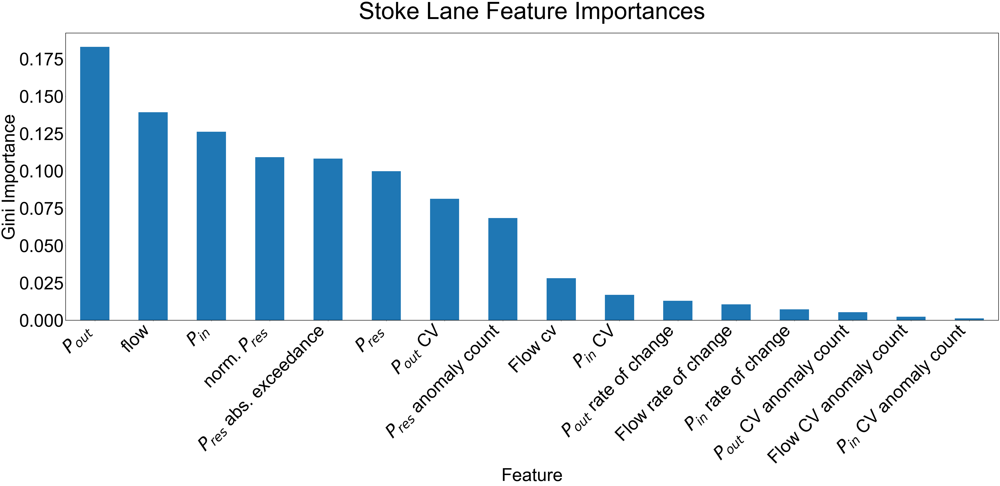

In [77]:
new_labels = [
    r'$P_{out}$', 'flow', r'$P_{in}$',  r'norm. $P_{res}$', r'$P_{res}$ abs. exceedance',r'$P_{res}$',r'$P_{out}$ CV',
    r'$P_{res}$ anomaly count', 'Flow cv',r'$P_{in}$ CV', r'$P_{out}$ rate of change', 
    'Flow rate of change',r'$P_{in}$ rate of change', r'$P_{out}$ CV anomaly count', 'Flow CV anomaly count', r'$P_{in}$ CV anomaly count'
]

top_features = importances.copy()

if len(top_features) != len(new_labels):
    raise ValueError(
        f"importances has length {len(top_features)}, but we provided {len(new_labels)} labels."
    )

top_features.index = new_labels

fig2, ax2 = plt.subplots()
top_features.plot(kind='bar', ax=ax2)
ax2.set_title('Stoke Lane Feature Importances', fontsize = 100)
ax2.set_ylabel('Gini Importance', fontsize = 75)
ax2.set_xlabel('Feature', fontsize = 75)

plt.xticks(rotation=45, ha='right', fontsize = 75)
plt.yticks(fontsize = 75)
plt.tight_layout()
plt.show()

### 7.3. Cross application

In [78]:
WoodlandWay_Flagged = pd.read_csv("../../Data/WoodlandWay/FlaggedData/Flagged_features_WW_labelled.csv", parse_dates=[0], index_col=0)
WoodlandWay_Flagged['label'].fillna('Unclassified', inplace=True)

Dropped 1305 rows with unseen labels.
=== WoodlandWay Test Classification Report ===
                                          precision    recall  f1-score   support

                                   Drift       0.00      0.00      0.00         0
                                 Failure       0.09      0.37      0.15       161
                  Further_classification       0.00      0.00      0.00        67
High_flow_dynamics_fixed_outlet_pressure       0.00      0.00      0.00         0
                       Large_step_change       0.11      1.00      0.20        24
                          Likely_failure       0.00      0.00      0.00       416
                           Speed_control       0.00      0.00      0.00       196
                         System_dynamics       0.15      0.11      0.12       147
                          Valve_dynamics       0.38      0.02      0.04       140

                                accuracy                           0.09      1151
           

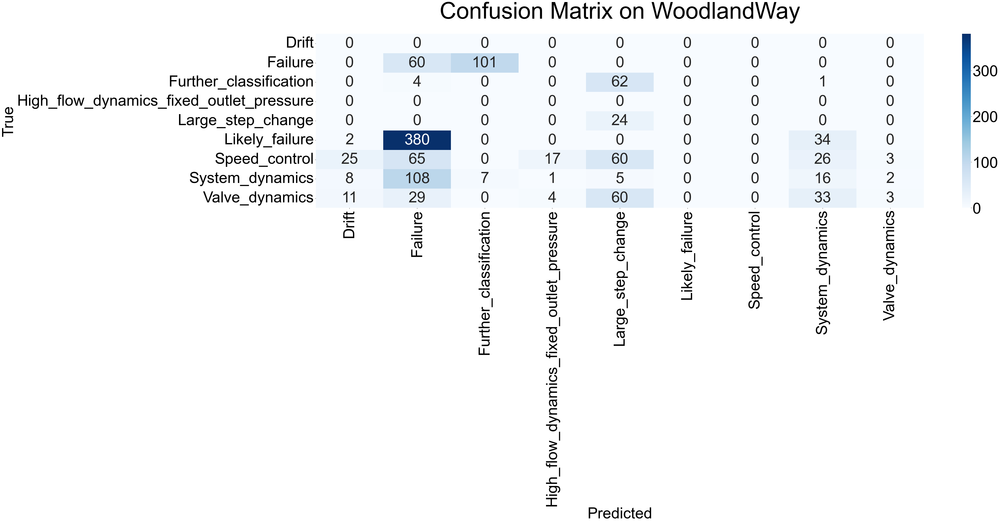

In [79]:
feature_cols = clf.feature_names_in_.tolist()

ww = WoodlandWay_Flagged.copy()
ww['label'] = ww['label'].astype(str)
mask = ww['label'].isin(clf.classes_)
dropped = (~mask).sum()
ww = ww[mask]
print(f"Dropped {dropped} rows with unseen labels.")


y_true = ww['label']
ww = ww.drop(columns=['label'])
obj_cols = ww.select_dtypes(include=['object','category']).columns.tolist()
if obj_cols:
    ww = pd.get_dummies(ww, columns=obj_cols, drop_first=True)
X_new = ww.reindex(columns=feature_cols, fill_value=0)

y_pred = clf.predict(X_new)

print("=== WoodlandWay Test Classification Report ===")
print(classification_report(y_true, y_pred))

cm = confusion_matrix(y_true, y_pred)
fig, ax = plt.subplots()
sns.heatmap(
    cm, annot=True, fmt='d',
    xticklabels=clf.classes_,
    yticklabels=clf.classes_,
    cmap='Blues',
    ax=ax
)
ax.set_title('Confusion Matrix on WoodlandWay')
ax.set_xlabel('Predicted')
ax.set_ylabel('True')
plt.tight_layout()
plt.show()

In [80]:
acc_overall = accuracy_score(y_true, y_pred)
print(f"Overall accuracy          : {acc_overall:.3f}")

prec_macro = precision_score(y_true, y_pred, average='macro', zero_division=0)
rec_macro  = recall_score(   y_true, y_pred, average='macro', zero_division=0)
f1_macro   = f1_score(      y_true, y_pred, average='macro', zero_division=0)
print(f"Macro‐averaged precision : {prec_macro:.3f}")
print(f"Macro‐averaged recall    : {rec_macro:.3f}")
print(f"Macro‐averaged F1        : {f1_macro:.3f}")

labels = list(clf.classes_)
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=labels, columns=labels)

fpr_dict = {}
for cls in labels:
    FP = cm_df[cls].sum() - cm_df.at[cls, cls]
    TN = cm_df.drop(index=cls, columns=cls).values.sum()
    fpr_dict[cls] = FP / (FP + TN) if (FP + TN) > 0 else 0.0

fpr_series = pd.Series(fpr_dict).sort_index()
print("\nFalse Positive Rate per class:")
print(fpr_series.to_frame(name="FPR"))

Overall accuracy          : 0.089
Macro‐averaged precision : 0.081
Macro‐averaged recall    : 0.167
Macro‐averaged F1        : 0.058

False Positive Rate per class:
                                               FPR
Drift                                     0.039965
Failure                                   0.591919
Further_classification                    0.099631
High_flow_dynamics_fixed_outlet_pressure  0.019114
Large_step_change                         0.165927
Likely_failure                            0.000000
Speed_control                             0.000000
System_dynamics                           0.093625
Valve_dynamics                            0.004946


In [81]:
labels = list(clf.classes_)
cm_full = confusion_matrix(y_true, y_pred, labels=labels)
cm_df   = pd.DataFrame(cm_full, index=labels, columns=labels)

total_FP = sum(
    cm_df[col].sum()  
    - cm_df.at[col, col]  
    for col in labels
)

total_TN = sum(
    cm_df.drop(index=cls, columns=cls).values.sum()
    for cls in labels
)

if (total_FP + total_TN) > 0:
    fpr_overall = total_FP / (total_FP + total_TN)
else:
    fpr_overall = 0.0

print(f"\nOverall False Positive Rate: {fpr_overall:.3f}")


Overall False Positive Rate: 0.114
